# Credit Score Classification
## Projeto final Machine Learning - MBA Data Science & Artificial Intelligence (4DTSR)
 Kaggle: https://www.kaggle.com/datasets/parisrohan/credit-score-classification/data

## 1. Bibliotecas

In [1]:
import pandas as pd
import numpy as np
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)
pd.set_option("display.max_rows", None)
pd.set_option('display.float_format', lambda x: '%.3f' % x)
import seaborn as sns
import matplotlib.pyplot as plt

import scipy.stats as stats
from scipy.stats import pearsonr
import statistics
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, accuracy_score, recall_score, precision_score, f1_score
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.ensemble import BaggingClassifier, GradientBoostingClassifier
from sklearn.preprocessing import StandardScaler

import warnings
warnings.filterwarnings('ignore')

## 2. Carregamento de dados e dicionário de dados

In [2]:
df_dict = pd.read_csv('./bases/dicionario_dados.csv', sep=';')
df_dict

,column,description_en,description_pt
0,ID,unique identification of an entry,identificação única de uma entrada
1,Customer_ID,unique identification of a person,identificação única de uma pessoa
2,Month,month of the year,o mês do ano
3,Name,name of a person,nome de uma pessoa
4,Age,age of the person,idade da pessoa
5,SSN,social security number of a person,número de segurança social de uma pessoa
6,Occupation,occupation of the person,ocupação da pessoa
7,Annual_Income,annual income of the person,renda anual da pessoa
8,Monthly_Inhand_Salary,monthly base salary of a person,salário base mensal da pessoa
9,Num_Bank_Accounts,number of bank accounts a person holds,número de contas bancárias que uma pessoa possui


In [3]:
df_train = pd.read_csv('./bases/train.csv')

In [4]:
df_train.shape

(100000, 28)

In [5]:
df_test = pd.read_csv('./bases/test.csv')

In [6]:
df_test.shape

(50000, 27)

### Análise preliminar dos dados

In [7]:
df_train.head(5)

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,0x1602,CUS_0xd40,January,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan, and Home Equity Loan",3,7,11.27,4.000,_,809.98,26.823,22 Years and 1 Months,No,49.575,80.41529543900253,High_spent_Small_value_payments,312.49408867943663,Good
1,0x1603,CUS_0xd40,February,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan, and Home Equity Loan",-1,NaN,11.27,4.000,Good,809.98,31.945,NaN,No,49.575,118.28022162236736,Low_spent_Large_value_payments,284.62916249607184,Good
2,0x1604,CUS_0xd40,March,Aaron Maashoh,-500,821-00-0265,Scientist,19114.12,NaN,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan, and Home Equity Loan",3,7,_,4.000,Good,809.98,28.609,22 Years and 3 Months,No,49.575,81.699521264648,Low_spent_Medium_value_payments,331.2098628537912,Good
3,0x1605,CUS_0xd40,April,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan, and Home Equity Loan",5,4,6.27,4.000,Good,809.98,31.378,22 Years and 4 Months,No,49.575,199.4580743910713,Low_spent_Small_value_payments,223.45130972736786,Good
4,0x1606,CUS_0xd40,May,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan, and Home Equity Loan",6,NaN,11.27,4.000,Good,809.98,24.797,22 Years and 5 Months,No,49.575,41.420153086217326,High_spent_Medium_value_payments,341.48923103222177,Good


In [8]:
df_test.head(5)

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance
0,0x160a,CUS_0xd40,September,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan, and Home Equity Loan",3,7,11.27,2022.000,Good,809.98,35.030,22 Years and 9 Months,No,49.575,236.64268203272135,Low_spent_Small_value_payments,186.26670208571772
1,0x160b,CUS_0xd40,October,Aaron Maashoh,24,821-00-0265,Scientist,19114.12,1824.843,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan, and Home Equity Loan",3,9,13.27,4.000,Good,809.98,33.053,22 Years and 10 Months,No,49.575,21.465380264657146,High_spent_Medium_value_payments,361.44400385378196
2,0x160c,CUS_0xd40,November,Aaron Maashoh,24,821-00-0265,Scientist,19114.12,1824.843,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan, and Home Equity Loan",-1,4,12.27,4.000,Good,809.98,33.812,NaN,No,49.575,148.23393788500925,Low_spent_Medium_value_payments,264.67544623342997
3,0x160d,CUS_0xd40,December,Aaron Maashoh,24_,821-00-0265,Scientist,19114.12,NaN,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan, and Home Equity Loan",4,5,11.27,4.000,Good,809.98,32.431,23 Years and 0 Months,No,49.575,39.08251089460281,High_spent_Medium_value_payments,343.82687322383634
4,0x1616,CUS_0x21b1,September,Rick Rothackerj,28,004-07-5839,_______,34847.84,3037.987,2,4,6,1,Credit-Builder Loan,3,1,5.42,5.000,Good,605.03,25.927,27 Years and 3 Months,No,18.816,39.684018417945296,High_spent_Large_value_payments,485.2984336755923


In [9]:
df_train.dtypes

ID                           object
Customer_ID                  object
Month                        object
Name                         object
Age                          object
SSN                          object
Occupation                   object
Annual_Income                object
Monthly_Inhand_Salary       float64
Num_Bank_Accounts             int64
Num_Credit_Card               int64
Interest_Rate                 int64
Num_of_Loan                  object
Type_of_Loan                 object
Delay_from_due_date           int64
Num_of_Delayed_Payment       object
Changed_Credit_Limit         object
Num_Credit_Inquiries        float64
Credit_Mix                   object
Outstanding_Debt             object
Credit_Utilization_Ratio    float64
Credit_History_Age           object
Payment_of_Min_Amount        object
Total_EMI_per_month         float64
Amount_invested_monthly      object
Payment_Behaviour            object
Monthly_Balance              object
Credit_Score                

In [10]:
display(
    df_train.describe(exclude=np.number).T, 
    print(), 
    df_test.describe(exclude=np.number).T
)

,count,unique,top,freq
ID,100000,100000,0x1602,1
Customer_ID,100000,12500,CUS_0xd40,8
Month,100000,8,January,12500
Name,90015,10139,Langep,44
Age,100000,1788,38,2833
SSN,100000,12501,#F%$D@*&8,5572
Occupation,100000,16,_______,7062
Annual_Income,100000,18940,36585.12,16
Num_of_Loan,100000,434,3,14386
Type_of_Loan,88592,6260,Not Specified,1408


None

,count,unique,top,freq
ID,50000,50000,0x160a,1
Customer_ID,50000,12500,CUS_0xd40,4
Month,50000,4,September,12500
Name,44985,10139,Stevex,22
Age,50000,976,39,1493
SSN,50000,12501,#F%$D@*&8,2828
Occupation,50000,16,_______,3438
Annual_Income,50000,16121,109945.32,8
Num_of_Loan,50000,263,2,7173
Type_of_Loan,44296,6260,Not Specified,704


Excesso de colunas numéricas que foram identificadas como string automaticamente, portanto necessário aplicar tratamento para retirar ruidos (caracteres especiais no meio de dados numéricos) dos dados

In [11]:
def clean_and_convert_column(df, column_name, target_dtype):
    """
    Limpa uma coluna de um DataFrame removendo caracteres não numéricos e converte para o tipo de dado desejado.

    Parâmetros:
    df (pandas.DataFrame): DataFrame que contém a coluna a ser processada.
    column_name (str): Nome da coluna a ser processada.
    target_dtype (type): Tipo de dado para o qual a coluna deve ser convertida.

    Retorna:
    pandas.DataFrame: DataFrame com a coluna especificada processada.
    """
    # Remove caracteres não numéricos
    df[column_name] = df[column_name].astype(str).str.replace(r'[^0-9.-]', '', regex=True)

    # Converte strings vazias para NaN e depois para um valor padrão antes de converter o tipo
    if target_dtype == int:
        df[column_name] = df[column_name].replace('', np.nan).fillna(0).astype(target_dtype)
    else: 
        df[column_name] = df[column_name].replace('', np.nan).astype(target_dtype)

    return df

In [12]:
columns_and_types = {
    'Annual_Income': float,
    'Num_of_Loan': int,
    'Delay_from_due_date': int,
    'Num_of_Delayed_Payment': int,
    'Changed_Credit_Limit': float,
    'Outstanding_Debt': float,
    'Amount_invested_monthly': float,
    'Monthly_Balance': float,
    'Age': int
}

for column, dtype in columns_and_types.items():
    df_train = clean_and_convert_column(df_train, column, dtype)

In [13]:
df_train.dtypes

ID                           object
Customer_ID                  object
Month                        object
Name                         object
Age                           int32
SSN                          object
Occupation                   object
Annual_Income               float64
Monthly_Inhand_Salary       float64
Num_Bank_Accounts             int64
Num_Credit_Card               int64
Interest_Rate                 int64
Num_of_Loan                   int32
Type_of_Loan                 object
Delay_from_due_date           int32
Num_of_Delayed_Payment        int32
Changed_Credit_Limit        float64
Num_Credit_Inquiries        float64
Credit_Mix                   object
Outstanding_Debt            float64
Credit_Utilization_Ratio    float64
Credit_History_Age           object
Payment_of_Min_Amount        object
Total_EMI_per_month         float64
Amount_invested_monthly     float64
Payment_Behaviour            object
Monthly_Balance             float64
Credit_Score                

In [14]:
df_train.shape, df_test.shape

((100000, 28), (50000, 27))

In [15]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 28 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        100000 non-null  object 
 1   Customer_ID               100000 non-null  object 
 2   Month                     100000 non-null  object 
 3   Name                      90015 non-null   object 
 4   Age                       100000 non-null  int32  
 5   SSN                       100000 non-null  object 
 6   Occupation                100000 non-null  object 
 7   Annual_Income             100000 non-null  float64
 8   Monthly_Inhand_Salary     84998 non-null   float64
 9   Num_Bank_Accounts         100000 non-null  int64  
 10  Num_Credit_Card           100000 non-null  int64  
 11  Interest_Rate             100000 non-null  int64  
 12  Num_of_Loan               100000 non-null  int32  
 13  Type_of_Loan              88592 non-null   ob

Mudança da variável Credit_History_Age que está misturado string e dados numéricos, para apenas dados numéricos

In [16]:
def convert_to_months(duration_str):
    """
    Converte uma string de duração no formato 'X Years and Y Months' para o total de meses.
    Se a entrada for NaN, retorna 0.

    Parâmetros:
    duration_str (str): String de duração a ser convertida.

    Retorna:
    int: Duração total em meses.
    """
    if pd.isna(duration_str):
        return 0

    parts = duration_str.split(' ')
    years = int(parts[0])
    months = int(parts[3]) if len(parts) > 3 else 0
    return years * 12 + months

In [17]:
df_train['Credit_History_Age_MONTH'] = df_train['Credit_History_Age'].apply(convert_to_months)

In [18]:
# Verificando valores ausentes
missing_values = df_train.isnull().sum().sort_values(ascending = False)
missing_values

# Checando percentual de valores missing
missing_values = missing_values[missing_values > 0] / df_train.shape[0] 
print(f'{missing_values * 100} %')

Monthly_Inhand_Salary     15.002
Type_of_Loan              11.408
Name                       9.985
Credit_History_Age         9.030
Amount_invested_monthly    4.479
Changed_Credit_Limit       2.091
Num_Credit_Inquiries       1.965
Monthly_Balance            1.200
dtype: float64 %


In [19]:
# Variáveis Numéricas
num_col = df_train.select_dtypes(include = np.number).columns
print("Variáveis Numéricas: \n", num_col)

# Variáveis Categóricas
cat_col = df_train.select_dtypes(exclude = np.number).columns
print("Variáveis Categóricas: \n", cat_col)

Variáveis Numéricas: 
 Index(['Age', 'Annual_Income', 'Monthly_Inhand_Salary', 'Num_Bank_Accounts',
       'Num_Credit_Card', 'Interest_Rate', 'Num_of_Loan',
       'Delay_from_due_date', 'Num_of_Delayed_Payment', 'Changed_Credit_Limit',
       'Num_Credit_Inquiries', 'Outstanding_Debt', 'Credit_Utilization_Ratio',
       'Total_EMI_per_month', 'Amount_invested_monthly', 'Monthly_Balance',
       'Credit_History_Age_MONTH'],
      dtype='object')
Variáveis Categóricas: 
 Index(['ID', 'Customer_ID', 'Month', 'Name', 'SSN', 'Occupation',
       'Type_of_Loan', 'Credit_Mix', 'Credit_History_Age',
       'Payment_of_Min_Amount', 'Payment_Behaviour', 'Credit_Score'],
      dtype='object')


In [20]:
# CHACAGEM DE COLUNAS DUPLICADAS
colunas_entrada = pd.Series(df_train.columns)
dup_cols = colunas_entrada[colunas_entrada.duplicated()]
print(dup_cols)
assert dup_cols.empty, "você duplicou colunas em cols_input"


Series([], dtype: object)


In [21]:
df_train.describe()

,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Outstanding_Debt,Credit_Utilization_Ratio,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Credit_History_Age_MONTH
count,100000.000,100000.000,84998.000,100000.000,100000.000,100000.000,100000.000,100000.000,100000.000,97909.000,98035.000,100000.000,100000.000,100000.000,95521.000,98800.000,100000.000
mean,110.650,176415.701,4194.171,17.091,22.474,72.466,3.010,21.069,28.758,10.389,27.754,1426.220,32.285,1403.118,637.413,-30364372469635625254912.000,201.221
std,686.245,1429618.051,3183.686,117.405,129.057,466.423,62.648,14.860,218.118,6.789,193.177,1155.129,5.117,8306.041,2043.319,3181295008384109317718016.000,114.321
min,-500.000,7005.930,303.645,-1.000,0.000,1.000,-100.000,-5.000,-3.000,-6.490,0.000,0.230,20.000,0.000,0.000,-333333333333333314856026112.000,0.000
25%,24.000,19457.500,1625.568,3.000,4.000,8.000,1.000,10.000,8.000,5.320,3.000,566.072,28.053,30.307,74.534,270.092,114.000
50%,33.000,37578.610,3093.745,6.000,5.000,13.000,3.000,18.000,13.000,9.400,6.000,1166.155,32.306,69.249,135.926,336.719,208.000
75%,42.000,72790.920,5957.448,7.000,7.000,20.000,5.000,28.000,18.000,14.870,9.000,1945.963,36.497,161.224,265.732,470.220,292.000
max,8698.000,24198062.000,15204.633,1798.000,1499.000,5797.000,1496.000,67.000,4397.000,36.970,2597.000,4998.070,50.000,82331.000,10000.000,1602.041,404.000


### Visualização da distribuição da variável target

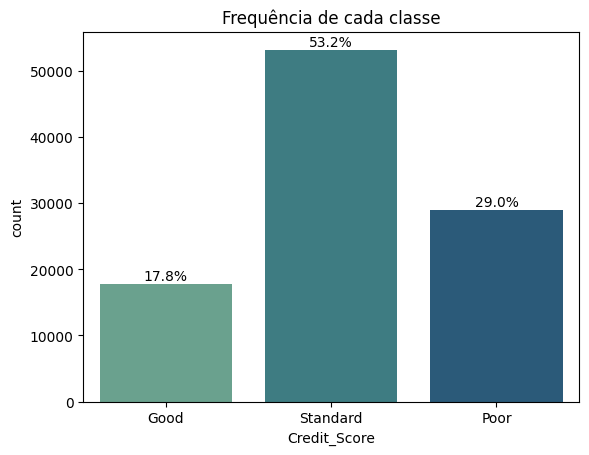

In [22]:
ax = sns.countplot(x='Credit_Score', data=df_train, palette="crest")
total = len(df_train['Credit_Score'])
counts = df_train['Credit_Score'].value_counts()

for p in ax.patches:
    percentage = f'{100 * p.get_height() / total:.1f}%'
    x = p.get_x() + p.get_width() / 2
    y = p.get_height()
    ax.annotate(percentage, (x, y), ha='center', va='bottom')
    
plt.title("Frequência de cada classe")
plt.show()


In [23]:
df_train['Credit_Score'].value_counts()

Credit_Score
Standard    53174
Poor        28998
Good        17828
Name: count, dtype: int64

### Visualização da condição dos dados para cada Customer_ID

In [24]:
df_train['Customer_ID'].value_counts()

Customer_ID
CUS_0xd40     8
CUS_0x9bf4    8
CUS_0x5ae3    8
CUS_0xbe9a    8
CUS_0x4874    8
CUS_0xc67b    8
CUS_0x8a64    8
CUS_0x35ea    8
CUS_0x5044    8
CUS_0x9dfd    8
CUS_0x513     8
CUS_0xba0b    8
CUS_0x9e7e    8
CUS_0x37dd    8
CUS_0x8873    8
CUS_0x61e0    8
CUS_0x7eb0    8
CUS_0x5fdb    8
CUS_0x8f16    8
CUS_0x3ff9    8
CUS_0x5e43    8
CUS_0x26e3    8
CUS_0x8d2     8
CUS_0x29b4    8
CUS_0x48f     8
CUS_0x1f64    8
CUS_0x8e81    8
CUS_0xb122    8
CUS_0x26e0    8
CUS_0x3499    8
CUS_0x45b     8
CUS_0x7666    8
CUS_0x696c    8
CUS_0x5499    8
CUS_0x6781    8
CUS_0xb171    8
CUS_0x5097    8
CUS_0xaa15    8
CUS_0x57b1    8
CUS_0x435d    8
CUS_0x2b39    8
CUS_0x2142    8
CUS_0xba6     8
CUS_0x5a4f    8
CUS_0xc60d    8
CUS_0x8a3f    8
CUS_0x5e22    8
CUS_0xb9a2    8
CUS_0x12af    8
CUS_0x6a6f    8
CUS_0x9d3     8
CUS_0x5d91    8
CUS_0x6ba7    8
CUS_0x1764    8
CUS_0x1971    8
CUS_0x4f07    8
CUS_0x6acc    8
CUS_0x5f02    8
CUS_0xbab8    8
CUS_0x2fb1    8
CUS_0x9d09    8
CUS_0x905   

> é possível visualizar que para cada Customer_ID, há pelo menos 8 registros

## 3. Análise univariada dados numéricos e feature engineering

Obs.: Como foi identificado pelo menos 8 registros para cada Customer_ID, para análise de ruido dos dados, foi utilizada a análise comportamental do próprio Customer_ID

Paso a passo para cada variável:
- Análise gráfica do dado bruto
- Obteção de informações da variável via função cria **get_column_details**
- Análise de ruido agrupada por customer_ID
- Aplicação da técnica de limpeza
- Visualização gráfica da variável tratada

In [25]:
def plot_countplot(df,column,user_friendly_column_name,rotation=0):
    print("\n-----------------------------------------------------")
    #print(f'\n{user_friendly_column_name} Distribution')
    palette = "deep" 
    sns.set_palette(palette)
    plt.figure(figsize=(10,6))
    sns.countplot(data=df, x=column)

    plt.xlabel(f'{column}')
    plt.ylabel('Number of Records')
    plt.title(f'Distribuição - {user_friendly_column_name}')
    plt.xticks(rotation=rotation)

    plt.show()

In [26]:

def plot_displot(df,column,user_friendly_column_name,rotation=0,bins=20):
    print("\n-----------------------------------------------------")
    #print(f'\n{user_friendly_column_name} Distribution')
    palette = "deep" 
    sns.set_palette(palette)
    plt.figure(figsize=(10,6))
    sns.displot(data=df, x=column, kde=True, bins=bins)

    plt.xlabel(f'{column}')
    plt.ylabel('Number of Records')
    plt.title(f'Distribuição - {user_friendly_column_name}')
    plt.xticks(rotation=rotation)

    plt.show()

In [27]:
def get_column_details(df,column):
    print("Details of",column,"column")
    
    #DataType of column
    print("\nDataType: ",df[column].dtype)
    
    #Check if null values are present
    count_null = df[column].isnull().sum()
    if count_null==0:
        print("\nThere are no null values")
    elif count_null>0:
        print("\nThere are ",count_null," null values")
        
    #Get Number of Unique Values
    print("\nNumber of Unique Values: ",df[column].nunique())
    
    #Get Distribution of Column    
    print("\nDistribution of column:\n")
    print(df[column].value_counts())

In [28]:
def fix_inconsistent_values(df, groupby, column):
    """
    Limpa valores inconsistentes em uma coluna de um DataFrame do pandas.
    
    Esta função agrupa os dados pela chave especificada, calcula o valor modal (mais comum)
    para cada grupo e utiliza esses valores para identificar e substituir outliers.
    Valores abaixo de zero ou fora do intervalo determinado pelos valores modais são considerados
    outliers e substituídos por NaN. Posteriormente, esses NaNs são preenchidos com o valor modal
    do grupo ou, se não estiver disponível, com a média da coluna.
    
    Parâmetros:
    - df (pandas.DataFrame): DataFrame contendo os dados a serem limpos.
    - groupby (str): Coluna pela qual o DataFrame será agrupado.
    - column (str): Coluna na qual os valores inconsistentes serão limpos.
    
    Retorna:
    - None: A função modifica o DataFrame 'df' in-place, não retornando nenhum valor.
    
    Imprime:
    - Valores mínimos e máximos antes e depois da limpeza.
    - Número de valores únicos após a limpeza.
    - Número de valores nulos após a limpeza.
    """
    
    # Imprime os valores mínimos e máximos atuais na coluna especificada.
    print("\nExisting Min, Max Values:", df[column].apply([min, max]), sep='\n', end='\n')   
    
    # Agrupa os dados pelo 'groupby' e aplica uma lista aos valores não nulos da coluna.
    df_dropped = df[df[column].notna()].groupby(groupby)[column].apply(list)

    # Calcula o valor modal para cada grupo.
    modals = df_dropped.apply(lambda x: stats.mode(x)[0] if x else np.nan)

    # Inicializa mini e maxi com valores extremos para posterior comparação.
    mini, maxi = float('inf'), float('-inf')

    # Itera sobre os valores modais para determinar os valores mínimos e máximos.
    for modal in modals:
        # Verifica se modal é um array NumPy e tem elementos.
        if isinstance(modal, np.ndarray) and modal.size > 0:
            modal_value = modal[0]  # Usa o primeiro elemento do array.
        elif isinstance(modal, (int, float)):
            modal_value = modal  # Usa o valor como está, se for numérico.
        else:
            continue  # Ignora valores que não são numéricos ou arrays NumPy.

        # Atualiza os valores mínimos e máximos.
        mini = min(mini, modal_value)
        maxi = max(maxi, modal_value)

    # Substitui valores fora do intervalo [mini, maxi] ou negativos por NaN.
    col = df[column].apply(lambda x: np.NaN if ((x < mini) | (x > maxi) | (x < 0)) else x)

    # Preenche NaN com o modo local ou, se não for possível, com a média da coluna.
    mode_by_group = df.groupby(groupby)[column].transform(lambda x: x.mode()[0] if not x.mode().empty else np.NaN)
    df[column] = col.fillna(mode_by_group)
    df[column].fillna(df[column].mean(), inplace=True)

    # Imprime os valores mínimos e máximos após a limpeza na coluna especificada.
    print("\nAfter Cleaning Min, Max Values:", df[column].apply([min, max]), sep='\n', end='\n') 
    # Imprime o número de valores únicos após a limpeza.
    print("\nNo. of Unique values after Cleaning:", df[column].nunique())
    # Imprime o número de valores nulos após a limpeza.
    print("\nNo. of Null values after Cleaning:", df[column].isnull().sum())

In [29]:
# Método para limpar campos numéricos em um DataFrame.
def clean_numerical_field(df, groupby, column, strip=None, datatype=None, replace_value=None):
    """
    Limpa um campo numérico em um DataFrame, tratando valores nulos e outliers, removendo caracteres
    indesejados e ajustando o tipo de dados da coluna.

    Esta função realiza a limpeza de valores específicos em uma coluna, substituindo-os por np.nan,
    remove caracteres especiais de strings, altera o tipo de dados da coluna e trata valores
    inconsistentes com base em um valor modal por grupo.

    Parâmetros:
    - df (pandas.DataFrame): DataFrame contendo os dados a serem limpos.
    - groupby (str): Coluna pela qual o DataFrame será agrupado.
    - column (str): Coluna na qual a limpeza será realizada.
    - strip (str, opcional): Caracteres a serem removidos dos valores da coluna.
    - datatype (type, opcional): Novo tipo de dados para a coluna.
    - replace_value (any, opcional): Valor específico na coluna a ser substituído por np.nan.

    Retorna:
    - None: A função modifica o DataFrame 'df' in-place, não retornando nenhum valor.

    Imprime:
    - Etapas de limpeza realizadas.
    """
    # Imprime um cabeçalho para indicar o início do processo de limpeza.
    print("\n-----------------------------------------------------")
    print("\nCleaning steps ")

    # Se um valor específico para substituição for fornecido, substitui esse valor por np.nan na coluna especificada.
    if replace_value != None:
        df[column] = df[column].replace(replace_value, np.nan)
        print(f"\nGarbage value {replace_value} is replaced with np.nan")

    # Se a coluna for do tipo objeto (string) e um caractere específico para remoção for fornecido,
    # remove esses caracteres do início e do fim de cada valor na coluna.
    if df[column].dtype == object and strip is not None:
        df[column] = df[column].str.strip(strip)
        print(f"\nTrailing & leading {strip} are removed")

    # Se um tipo de dados específico for fornecido, converte a coluna para esse tipo de dados.
    if datatype is not None:
        df[column] = df[column].astype(datatype)
        print(f"\nDatatype of {column} is changed to {datatype}")

    # Chama a função fix_inconsistent_values para lidar com outliers e valores nulos na coluna.
    fix_inconsistent_values(df, groupby, column)

#### Variável: **Age**

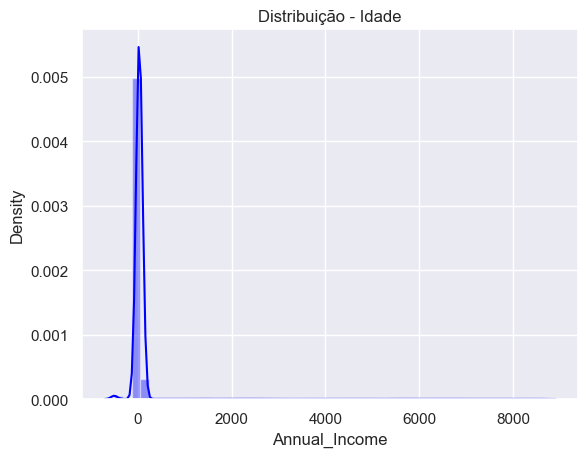

In [30]:
sns.set(style="darkgrid")
sns.distplot(df_train['Age'], kde=True, color='blue')
plt.xlabel('Annual_Income')
plt.ylabel('Density')
plt.title('Distribuição - Idade')
plt.show()

In [31]:
get_column_details(df_train,'Age')

Details of Age column

DataType:  int32

There are no null values

Number of Unique Values:  1728

Distribution of column:

Age
 38      2994
 28      2968
 31      2955
 26      2945
 32      2884
 36      2868
 35      2866
 25      2861
 27      2859
 39      2846
 34      2837
 44      2824
 19      2793
 22      2785
 41      2785
 20      2744
 37      2742
 29      2735
 43      2734
 30      2727
 21      2716
 24      2714
 23      2654
 45      2642
 40      2609
 42      2577
 33      2543
 18      2385
 46      1621
 15      1574
 17      1502
 16      1455
 48      1385
 49      1375
 55      1366
 52      1356
 53      1354
 54      1311
 51      1291
 50      1273
 47      1227
 14      1175
-500      886
 56       362
 6799       4
 3640       3
 2650       3
 2546       3
 5579       3
 6381       3
 8015       3
 95         3
 4307       3
 3439       3
 532        3
 2756       3
 2980       3
 1753       3
 2109       3
 1695       3
 1692       3
 4083       3
 449

In [32]:
unique_Age = df_train.groupby('Customer_ID')['Age'].nunique()
customer_ids_Age = unique_Age[unique_Age > 1].index
df_Age = df_train[df_train['Customer_ID'].isin(customer_ids_Age)][['Customer_ID', 'Age']]

In [33]:
df_Age.head(20)

,Customer_ID,Age
0,CUS_0xd40,23
1,CUS_0xd40,23
2,CUS_0xd40,-500
3,CUS_0xd40,23
4,CUS_0xd40,23
5,CUS_0xd40,23
6,CUS_0xd40,23
7,CUS_0xd40,23
24,CUS_0xb891,54
25,CUS_0xb891,54



-----------------------------------------------------

Cleaning steps 

Datatype of Age is changed to int

Existing Min, Max Values:
min    -500
max    8698
Name: Age, dtype: int64

After Cleaning Min, Max Values:
min   14.000
max   56.000
Name: Age, dtype: float64

No. of Unique values after Cleaning: 43

No. of Null values after Cleaning: 0

-----------------------------------------------------


<Figure size 1000x600 with 0 Axes>

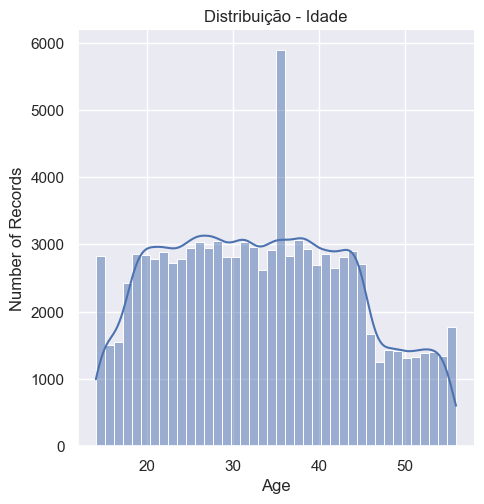

In [34]:
column_name = 'Age'
group_by = 'Customer_ID'
user_friendly_name = 'Idade'

#Cleaning
clean_numerical_field(df_train,group_by,column_name,strip='_',datatype='int')

#Plot Graph
plot_displot(df_train,column_name,user_friendly_name,bins=40)

#### Variável: **Annual_Income**

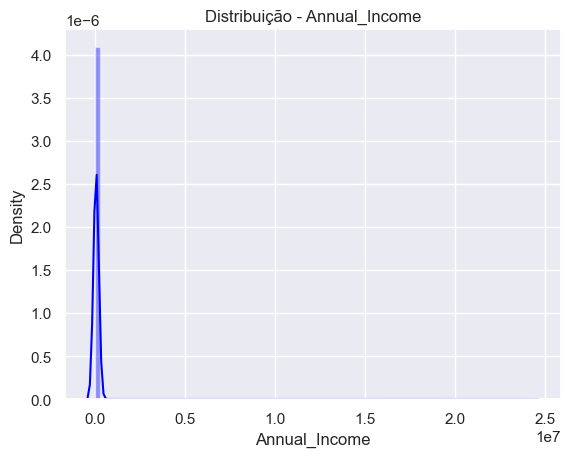

In [35]:
sns.set(style="darkgrid")
sns.distplot(df_train['Annual_Income'], kde=True, color='blue', bins=100)
plt.xlabel('Annual_Income')
plt.ylabel('Density')
plt.title('Distribuição - Annual_Income')
plt.show()

In [36]:
get_column_details(df_train,'Annual_Income')

Details of Annual_Income column

DataType:  float64

There are no null values

Number of Unique Values:  13487

Distribution of column:

Annual_Income
17816.750       16
22434.160       16
40341.160       16
17273.830       16
109945.320      16
32543.380       16
9141.630        16
20867.670       16
36585.120       16
95596.350       15
33029.660       15
72524.200       15
60323.340        8
40626.050        8
19047.360        8
17214.010        8
133628.520       8
81538.760        8
17951.300        8
18374.320        8
7710.840         8
56052.420        8
57563.940        8
25773.730        8
17685.730        8
31944.720        8
57810.680        8
15005.310        8
19114.120        8
33498.800        8
35389.890        8
60530.700        8
17443.940        8
31199.430        8
56089.950        8
17971.000        8
19104.750        8
125977.600       8
134124.000       8
34613.160        8
122135.120       8
17426.710        8
65544.120        8
116098.120       8
71203.400    

In [37]:
df_train['Month'] = pd.to_datetime(df_train.Month, format='%B').dt.month

In [38]:
df_Annual_Income =  df_train[['Customer_ID','Month', 'Annual_Income']]

In [39]:
df_Annual_Income.head(20)

,Customer_ID,Month,Annual_Income
0,CUS_0xd40,1,19114.120
1,CUS_0xd40,2,19114.120
2,CUS_0xd40,3,19114.120
3,CUS_0xd40,4,19114.120
4,CUS_0xd40,5,19114.120
5,CUS_0xd40,6,19114.120
6,CUS_0xd40,7,19114.120
7,CUS_0xd40,8,19114.120
8,CUS_0x21b1,1,34847.840
9,CUS_0x21b1,2,34847.840


In [40]:
unique_incomes = df_train.groupby('Customer_ID')['Annual_Income'].nunique()
customer_ids_with_varied_income = unique_incomes[unique_incomes > 1].index
df_varied_income = df_train[df_train['Customer_ID'].isin(customer_ids_with_varied_income)][['Customer_ID', 'Annual_Income']]


In [41]:
df_varied_income.head(50)

,Customer_ID,Annual_Income
48,CUS_0x284a,131313.400
49,CUS_0x284a,131313.400
50,CUS_0x284a,131313.400
51,CUS_0x284a,131313.400
52,CUS_0x284a,131313.400
53,CUS_0x284a,131313.400
54,CUS_0x284a,10909427.000
55,CUS_0x284a,131313.400
224,CUS_0xbffe,28572.390
225,CUS_0xbffe,28572.390


<Axes: xlabel='Annual_Income'>

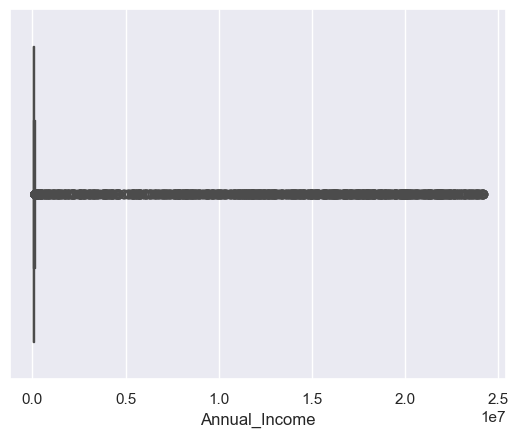

In [42]:
sns.boxplot(x=df_train['Annual_Income'])


-----------------------------------------------------

Cleaning steps 

Datatype of Annual_Income is changed to float

Existing Min, Max Values:
min       7005.930
max   24198062.000
Name: Annual_Income, dtype: float64

After Cleaning Min, Max Values:
min     7005.930
max   179987.280
Name: Annual_Income, dtype: float64

No. of Unique values after Cleaning: 12488

No. of Null values after Cleaning: 0

-----------------------------------------------------


<Figure size 1000x600 with 0 Axes>

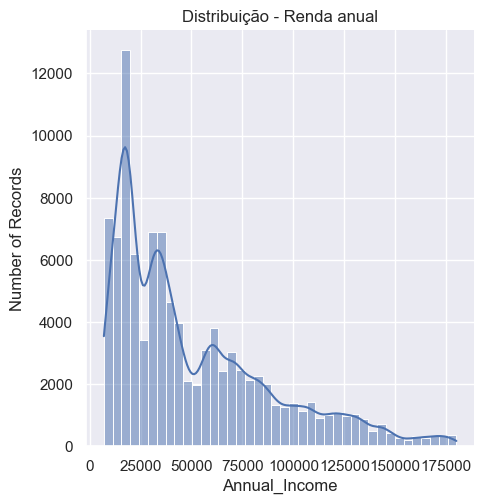

In [43]:
column_name = 'Annual_Income'
group_by = 'Customer_ID'
user_friendly_name = 'Renda anual'

#Cleaning
clean_numerical_field(df_train,group_by,column_name,strip='_',datatype='float')

#Plot Graph
plot_displot(df_train,column_name,user_friendly_name,bins=40)

<Axes: xlabel='Annual_Income'>

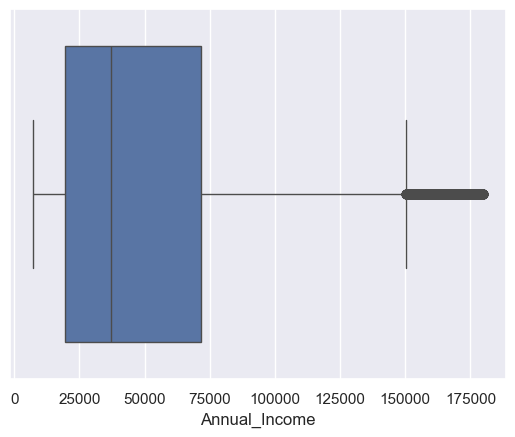

In [44]:
sns.boxplot(x=df_train['Annual_Income'])

#### Variável: **Monthly_Inhand_Salary**

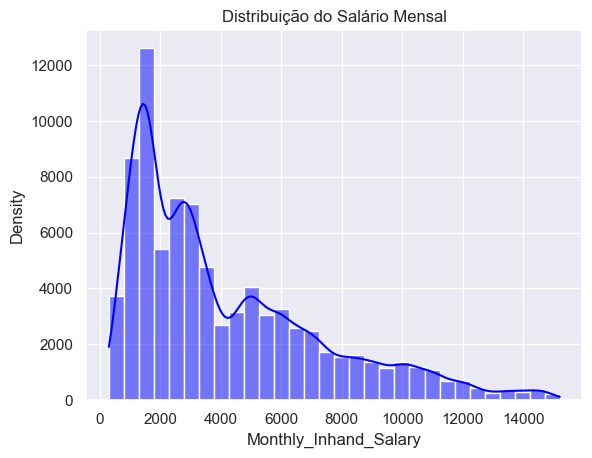

In [45]:
sns.set(style="darkgrid")
sns.histplot(df_train['Monthly_Inhand_Salary'], kde=True, color='blue', bins=30)
plt.xlabel('Monthly_Inhand_Salary')
plt.ylabel('Density')
plt.title('Distribuição do Salário Mensal')
plt.show()

In [46]:
df_train['Monthly_Inhand_Salary'].value_counts()

Monthly_Inhand_Salary
6769.130     15
6358.957     15
2295.058     15
6082.188     15
3080.555     14
4387.273     13
5766.492     13
6639.560     13
536.431      12
1315.561     11
2557.862      9
1476.063      8
2610.172      8
9641.480      8
11624.847     8
1393.487      8
1801.474      8
7554.578      8
1365.173      8
1474.625      8
4354.813      8
8002.350      8
1739.662      8
11162.153     8
2533.776      8
7842.322      8
2188.398      8
1108.902      8
1359.206      8
1507.336      8
5028.165      8
6596.467      8
1375.585      8
3459.660      8
5910.960      8
3359.416      8
1095.918      8
1932.283      8
1943.841      8
1082.504      8
2905.198      8
824.415       8
2217.162      8
6130.987      8
3506.253      8
1938.303      8
817.100       8
1198.615      8
1796.880      8
1505.762      8
5109.440      8
4356.750      8
1022.133      8
5474.332      8
6140.407      8
6390.847      8
4633.462      8
4860.830      8
1047.222      8
660.136       8
1107.625      8
14


-----------------------------------------------------

Cleaning steps 

Existing Min, Max Values:
min     303.645
max   15204.633
Name: Monthly_Inhand_Salary, dtype: float64

After Cleaning Min, Max Values:
min     303.645
max   15204.633
Name: Monthly_Inhand_Salary, dtype: float64

No. of Unique values after Cleaning: 13235

No. of Null values after Cleaning: 0

-----------------------------------------------------


<Figure size 1000x600 with 0 Axes>

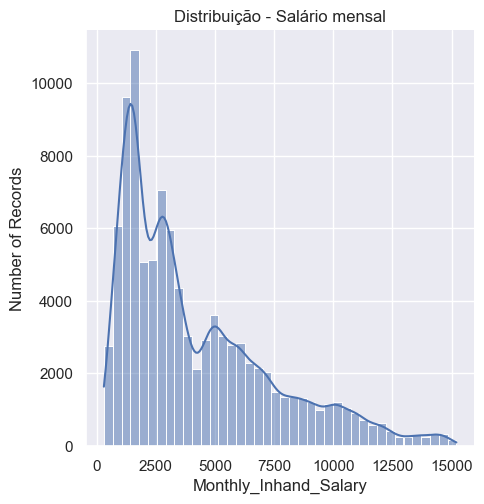

In [47]:
column_name = 'Monthly_Inhand_Salary'
group_by = 'Customer_ID'
user_friendly_name = 'Salário mensal'

#Cleaning
clean_numerical_field(df_train,group_by,column_name)

#Plot Graph
plot_displot(df_train,column_name,user_friendly_name,bins=40)

#### Variável: **Num_Bank_Accounts**

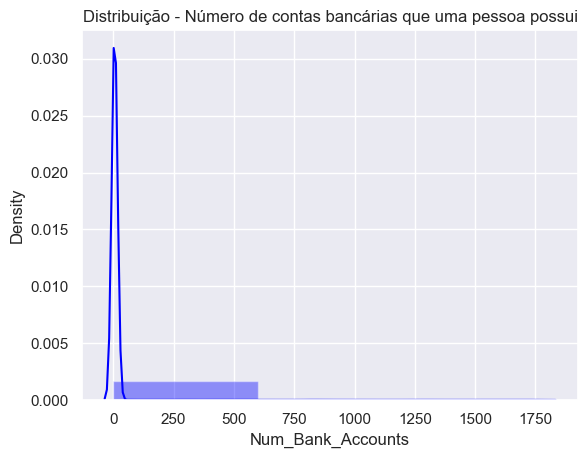

In [48]:
sns.distplot(df_train['Num_Bank_Accounts'], kde=True, color='blue', bins=3)
plt.xlabel('Num_Bank_Accounts')
plt.ylabel('Density')
plt.title('Distribuição - Número de contas bancárias que uma pessoa possui')
plt.show()

In [49]:
get_column_details(df_train,'Num_Bank_Accounts')

Details of Num_Bank_Accounts column

DataType:  int64

There are no null values

Number of Unique Values:  943

Distribution of column:

Num_Bank_Accounts
 6       13001
 7       12823
 8       12765
 4       12186
 5       12118
 3       11950
 9        5443
 10       5247
 1        4490
 0        4328
 2        4304
-1          21
 11          9
 803         7
 1668        5
 791         5
 105         5
 210         4
 1139        4
 1096        4
 1481        4
 1033        4
 857         4
 34          4
 312         4
 1257        4
 43          4
 170         3
 1478        3
 812         3
 903         3
 584         3
 610         3
 1065        3
 1577        3
 505         3
 882         3
 933         3
 809         3
 1124        3
 1089        3
 1747        3
 28          3
 179         3
 632         3
 1114        3
 786         3
 596         3
 137         3
 527         3
 687         3
 1756        3
 229         3
 330         3
 265         3
 1137        3
 196 

In [50]:
unique_Num_Bank_Accounts = df_train.groupby('Customer_ID')['Num_Bank_Accounts'].nunique()
customer_ids_Num_Bank_Accounts = unique_Num_Bank_Accounts[unique_Num_Bank_Accounts > 1].index
df_varied_Num_Bank_Accounts = df_train[df_train['Customer_ID'].isin(customer_ids_Num_Bank_Accounts)][['Customer_ID', 'Num_Bank_Accounts']]

In [51]:
df_varied_Num_Bank_Accounts.head(20)

,Customer_ID,Num_Bank_Accounts
72,CUS_0xba08,0
73,CUS_0xba08,1
74,CUS_0xba08,1
75,CUS_0xba08,1
76,CUS_0xba08,1
77,CUS_0xba08,1
78,CUS_0xba08,1
79,CUS_0xba08,1
264,CUS_0x4004,8
265,CUS_0x4004,8



-----------------------------------------------------

Cleaning steps 

Existing Min, Max Values:
min      -1
max    1798
Name: Num_Bank_Accounts, dtype: int64

After Cleaning Min, Max Values:
min   -1.000
max   10.000
Name: Num_Bank_Accounts, dtype: float64

No. of Unique values after Cleaning: 12

No. of Null values after Cleaning: 0

-----------------------------------------------------


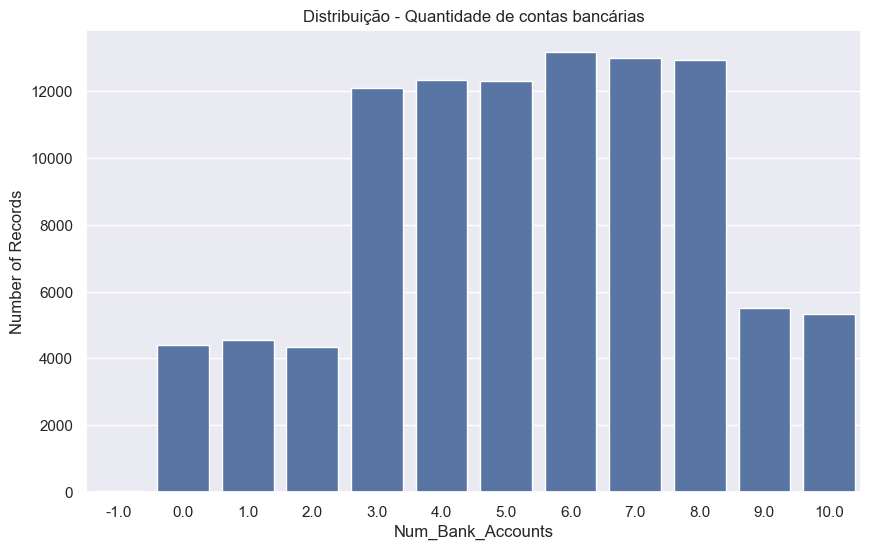

In [52]:
column_name = 'Num_Bank_Accounts'
group_by = 'Customer_ID'
user_friendly_name = 'Quantidade de contas bancárias'

#Cleaning
clean_numerical_field(df_train,group_by,column_name)

#Plot Graph
plot_countplot(df_train,column_name,user_friendly_name)

In [53]:
df_train[df_train['Num_Bank_Accounts'] < 0][['Customer_ID', 'Num_Bank_Accounts']]

,Customer_ID,Num_Bank_Accounts
30330,CUS_0x4f2a,-1.000
30331,CUS_0x4f2a,-1.000
30332,CUS_0x4f2a,-1.000
30333,CUS_0x4f2a,-1.000
30334,CUS_0x4f2a,-1.000
30335,CUS_0x4f2a,-1.000
43689,CUS_0xa878,-1.000
43690,CUS_0xa878,-1.000
43691,CUS_0xa878,-1.000
43692,CUS_0xa878,-1.000


In [54]:
df_train['Num_Bank_Accounts'] = df_train['Num_Bank_Accounts'].replace(-1, 0)


-----------------------------------------------------


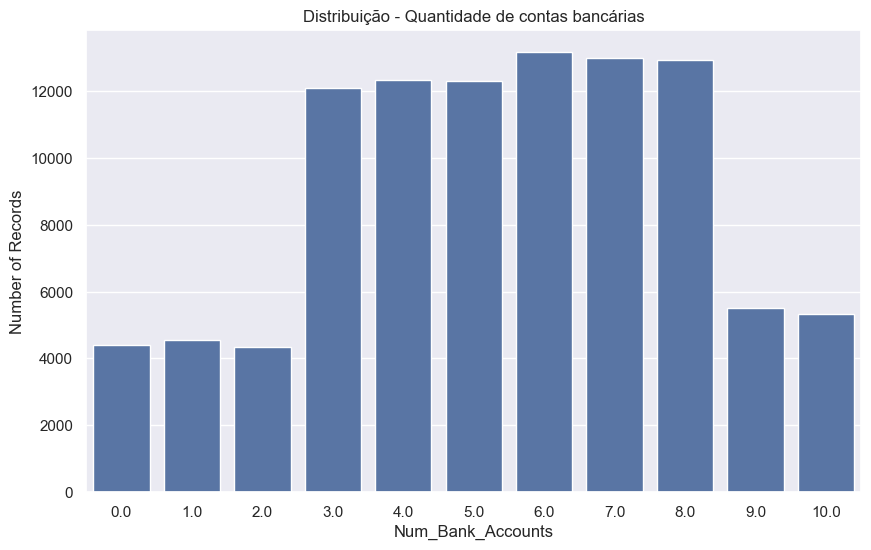

In [55]:
column_name = 'Num_Bank_Accounts'
user_friendly_name = 'Quantidade de contas bancárias'

#Plot Graph
plot_countplot(df_train,column_name,user_friendly_name)

#### Variável: **Num_Credit_Card**

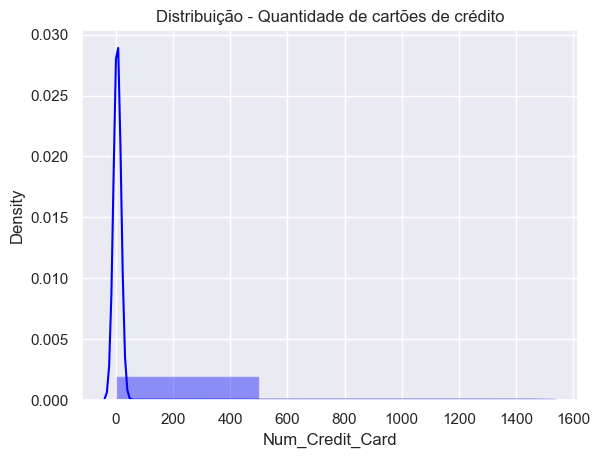

In [56]:
sns.distplot(df_train['Num_Credit_Card'], kde=True, color='blue', bins=3)
plt.xlabel('Num_Credit_Card')
plt.ylabel('Density')
plt.title('Distribuição - Quantidade de cartões de crédito')
plt.show()

In [57]:
get_column_details(df_train,'Num_Credit_Card')

Details of Num_Credit_Card column

DataType:  int64

There are no null values

Number of Unique Values:  1179

Distribution of column:

Num_Credit_Card
5       18459
7       16615
6       16559
4       14030
3       13277
8        4956
10       4860
9        4643
2        2149
1        2132
11         36
0          13
849         8
852         7
183         6
106         6
1420        6
958         6
159         6
331         6
92          6
218         6
891         5
1223        5
180         5
399         5
1105        5
253         5
1217        5
1403        5
1323        5
1299        5
924         5
501         5
461         5
1391        5
147         5
1007        5
1130        5
579         5
157         5
104         5
25          5
870         5
298         4
970         4
698         4
43          4
1090        4
275         4
311         4
535         4
896         4
1449        4
1475        4
66          4
732         4
458         4
677         4
1077        4
1009    

<Axes: xlabel='Num_Credit_Card'>

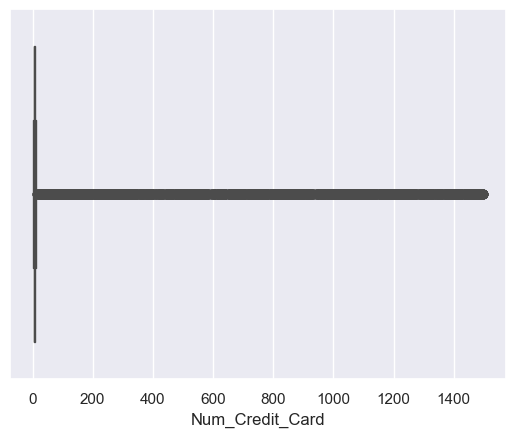

In [58]:
sns.boxplot(x=df_train['Num_Credit_Card'])

In [59]:
unique_Num_Credit_Card = df_train.groupby('Customer_ID')['Num_Credit_Card'].nunique()
customer_ids_Num_Credit_Card = unique_Num_Credit_Card[unique_Num_Credit_Card > 1].index
df_Num_Credit_Card = df_train[df_train['Customer_ID'].isin(customer_ids_Num_Credit_Card )][['Customer_ID', 'Num_Credit_Card']]

In [60]:
df_Num_Credit_Card.head(20)

,Customer_ID,Num_Credit_Card
8,CUS_0x21b1,4
9,CUS_0x21b1,4
10,CUS_0x21b1,1385
11,CUS_0x21b1,4
12,CUS_0x21b1,4
13,CUS_0x21b1,4
14,CUS_0x21b1,4
15,CUS_0x21b1,4
40,CUS_0x95ee,1288
41,CUS_0x95ee,5



-----------------------------------------------------

Cleaning steps 

Existing Min, Max Values:
min       0
max    1499
Name: Num_Credit_Card, dtype: int64

After Cleaning Min, Max Values:
min    0.000
max   11.000
Name: Num_Credit_Card, dtype: float64

No. of Unique values after Cleaning: 12

No. of Null values after Cleaning: 0

-----------------------------------------------------


<Figure size 1000x600 with 0 Axes>

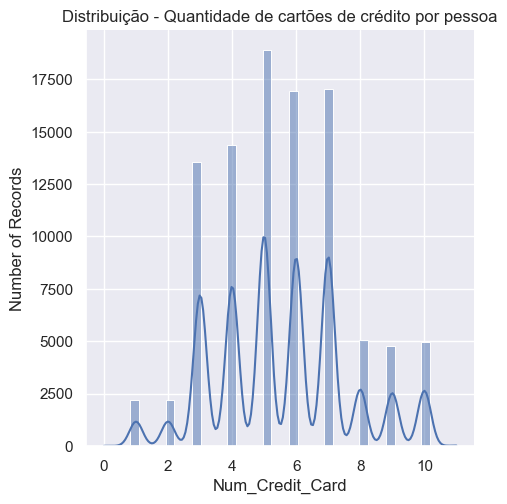

In [61]:
column_name = 'Num_Credit_Card'
group_by = 'Customer_ID'
user_friendly_name = 'Quantidade de cartões de crédito por pessoa'

#Cleaning
clean_numerical_field(df_train,group_by,column_name)

#Plot Graph
plot_displot(df_train,column_name,user_friendly_name,bins=40)

<Axes: xlabel='Num_Credit_Card'>

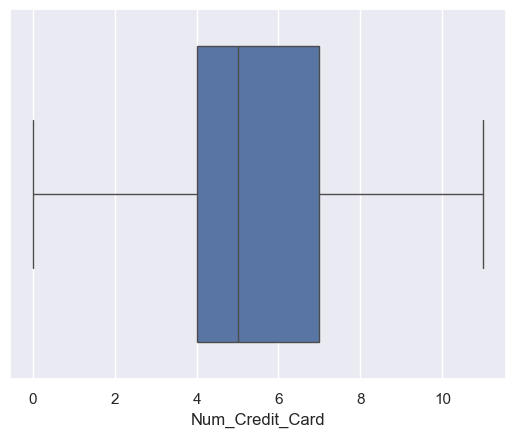

In [62]:
sns.boxplot(x=df_train['Num_Credit_Card'])

#### Variável: **Interest_Rate**

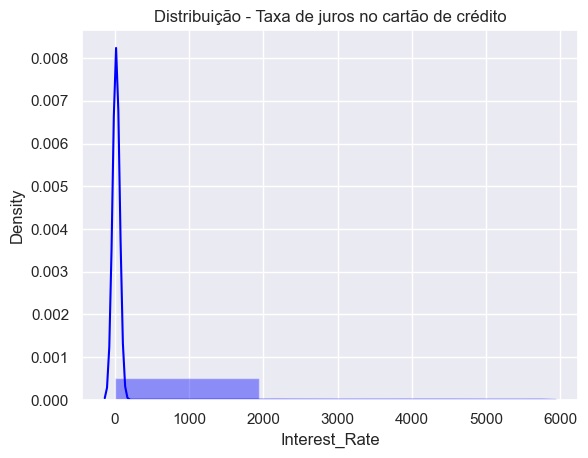

In [63]:
sns.distplot(df_train['Interest_Rate'], kde=True, color='blue', bins=3)
plt.xlabel('Interest_Rate')
plt.ylabel('Density')
plt.title('Distribuição - Taxa de juros no cartão de crédito')
plt.show()

In [64]:
get_column_details(df_train,'Interest_Rate')

Details of Interest_Rate column

DataType:  int64

There are no null values

Number of Unique Values:  1750

Distribution of column:

Interest_Rate
8       5012
5       4979
6       4721
12      4540
10      4540
9       4494
7       4494
11      4428
18      4102
15      3992
20      3929
17      3813
16      3730
19      3630
3       2765
1       2683
4       2589
2       2465
13      2384
14      2229
32      1742
22      1720
30      1690
24      1685
23      1683
29      1662
28      1616
27      1608
25      1566
21      1560
34      1502
26      1489
33      1467
31      1457
498        4
4676       4
3089       4
1944       4
2173       3
1292       3
2158       3
1913       3
2091       3
3801       3
2874       3
3244       3
4264       3
1884       3
3672       3
2571       3
3868       3
1275       3
2059       3
4093       3
5078       3
4396       3
1208       3
2723       3
1384       3
3834       3
5598       3
552        3
964        3
2304       3
2510       3
207    

In [65]:
unique_Interest_Rate = df_train.groupby('Customer_ID')['Interest_Rate'].nunique()
customer_ids_Interest_Rate = unique_Interest_Rate[unique_Interest_Rate > 1].index
df_varied_Interest_Rate = df_train[df_train['Customer_ID'].isin(customer_ids_Interest_Rate)][['Customer_ID', 'Interest_Rate']]

In [66]:
df_varied_Interest_Rate.head(20)

,Customer_ID,Interest_Rate
40,CUS_0x95ee,8
41,CUS_0x95ee,8
42,CUS_0x95ee,8
43,CUS_0x95ee,8
44,CUS_0x95ee,5318
45,CUS_0x95ee,8
46,CUS_0x95ee,8
47,CUS_0x95ee,8
88,CUS_0xc0ab,1
89,CUS_0xc0ab,433



-----------------------------------------------------

Cleaning steps 

Existing Min, Max Values:
min       1
max    5797
Name: Interest_Rate, dtype: int64

After Cleaning Min, Max Values:
min    1.000
max   34.000
Name: Interest_Rate, dtype: float64

No. of Unique values after Cleaning: 34

No. of Null values after Cleaning: 0

-----------------------------------------------------


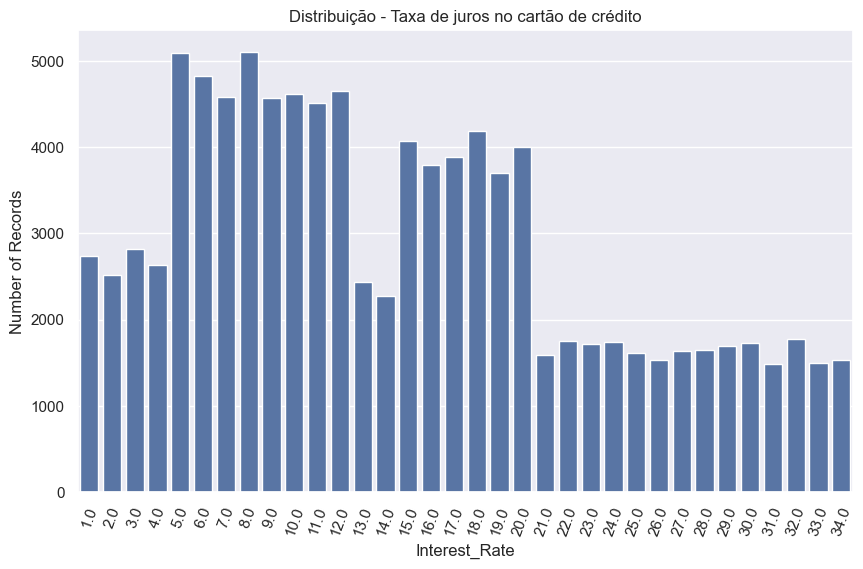

In [67]:
column_name = 'Interest_Rate'
group_by = 'Customer_ID'
user_friendly_name = 'Taxa de juros no cartão de crédito'

#Cleaning
clean_numerical_field(df_train,group_by,column_name)

#Plot Graph
plot_countplot(df_train,column_name,user_friendly_name, 70)

#### Variável: **Num_of_Loan**

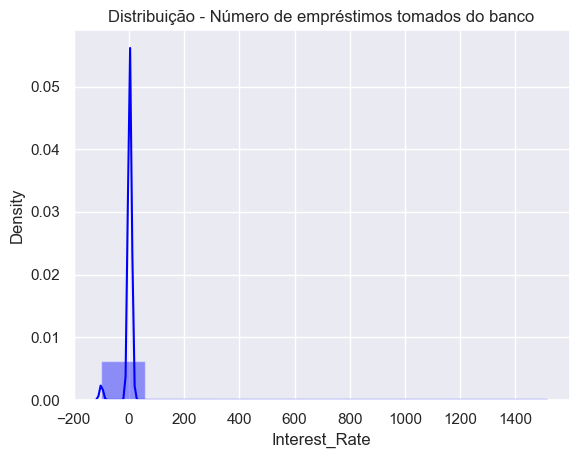

In [68]:
sns.distplot(df_train['Num_of_Loan'], kde=True, color='blue', bins=10)
plt.xlabel('Interest_Rate')
plt.ylabel('Density')
plt.title('Distribuição - Número de empréstimos tomados do banco')
plt.show()

In [69]:
get_column_details(df_train,'Num_of_Loan')

Details of Num_of_Loan column

DataType:  int32

There are no null values

Number of Unique Values:  414

Distribution of column:

Num_of_Loan
 3       15104
 2       15032
 4       14743
 0       10930
 1       10606
 6        7803
 7        7344
 5        7197
-100      3876
 9        3702
 8        3191
 1150        4
 1228        3
 1480        3
 288         3
 773         3
 430         3
 227         2
 1131        2
 192         2
 284         2
 898         2
 1354        2
 404         2
 23          2
 1241        2
 527         2
 1259        2
 143         2
 290         2
 1181        2
 229         2
 911         2
 696         2
 1209        2
 359         2
 275         2
 1353        2
 95          2
 1463        2
 855         2
 1320        2
 172         2
 141         2
 697         2
 1384        2
 733         2
 1127        2
 1412        2
 251         2
 1129        2
 50          2
 875         2
 217         2
 1365        2
 58          2
 955         2
 6

In [70]:
unique_Num_of_Loan = df_train.groupby('Customer_ID')['Num_of_Loan'].nunique()
customer_ids_Num_of_Loan = unique_Num_of_Loan[unique_Num_of_Loan > 1].index
df_varied_Num_of_Loan = df_train[df_train['Customer_ID'].isin(customer_ids_Num_of_Loan)][['Customer_ID', 'Num_of_Loan']]

In [71]:
df_varied_Num_of_Loan.head(20)

,Customer_ID,Num_of_Loan
16,CUS_0x2dbc,3
17,CUS_0x2dbc,3
18,CUS_0x2dbc,3
19,CUS_0x2dbc,3
20,CUS_0x2dbc,3
21,CUS_0x2dbc,967
22,CUS_0x2dbc,3
23,CUS_0x2dbc,3
24,CUS_0xb891,1
25,CUS_0xb891,1



-----------------------------------------------------

Cleaning steps 

Existing Min, Max Values:
min    -100
max    1496
Name: Num_of_Loan, dtype: int64

After Cleaning Min, Max Values:
min   0.000
max   9.000
Name: Num_of_Loan, dtype: float64

No. of Unique values after Cleaning: 10

No. of Null values after Cleaning: 0

-----------------------------------------------------


<Figure size 1000x600 with 0 Axes>

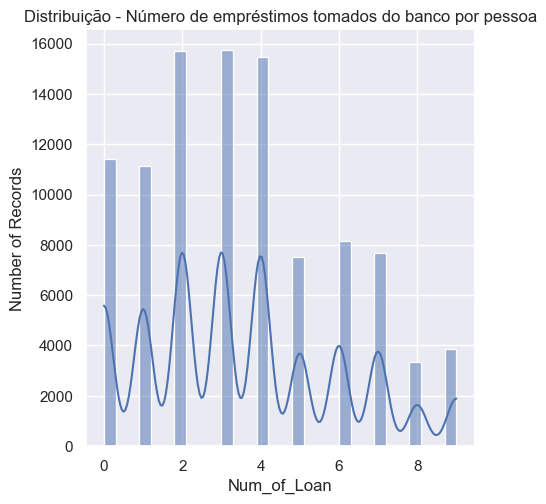

In [72]:
column_name = 'Num_of_Loan'
group_by = 'Customer_ID'
user_friendly_name = 'Número de empréstimos tomados do banco por pessoa'

#Cleaning
clean_numerical_field(df_train,group_by,column_name)

#Plot Graph
plot_displot(df_train,column_name,user_friendly_name,bins=30)

#### Variável: **Delay_from_due_date**

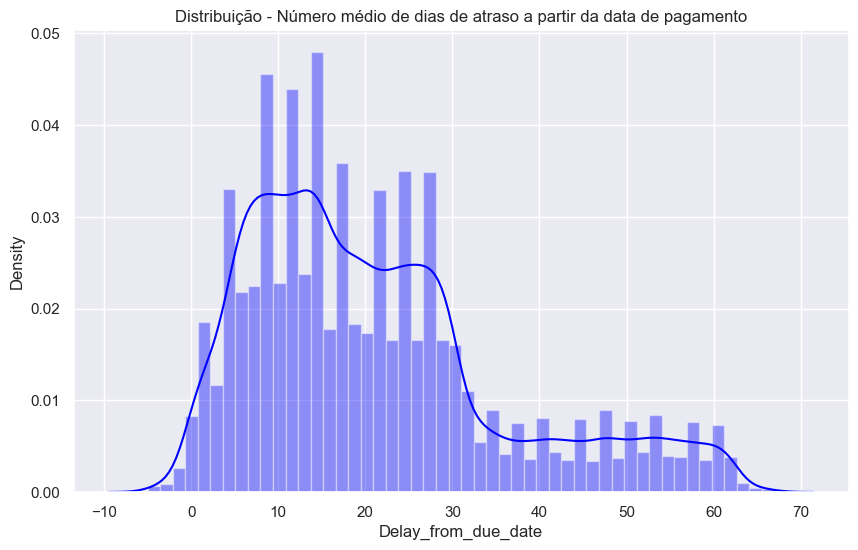

In [73]:
plt.figure(figsize=(10,6))
sns.distplot(df_train['Delay_from_due_date'], kde=True, color='blue')
plt.xlabel('Delay_from_due_date')
plt.title('Distribuição - Número médio de dias de atraso a partir da data de pagamento')
plt.show()

In [74]:
get_column_details(df_train,'Delay_from_due_date')

Details of Delay_from_due_date column

DataType:  int32

There are no null values

Number of Unique Values:  73

Distribution of column:

Delay_from_due_date
 15    3596
 13    3424
 8     3324
 14    3313
 10    3281
 7     3234
 9     3233
 11    3182
 12    3141
 6     3137
 5     3042
 19    2638
 18    2637
 27    2623
 16    2566
 24    2533
 17    2524
 25    2506
 20    2489
 21    2411
 28    2397
 23    2387
 26    2386
 29    2383
 22    2334
 30    2309
 4     1722
 3     1686
 2     1342
 1     1326
 0     1195
 31     802
 33     791
 32     787
 34     675
 47     654
 48     628
 52     625
 54     624
 42     623
 35     614
 44     602
 36     594
 38     592
 41     586
 53     585
 50     576
 40     572
 55     560
 56     555
 58     553
 57     552
 62     545
 49     538
 45     536
 51     535
 60     533
 39     525
 61     514
 59     507
 43     502
 37     490
 46     490
-1      210
-2      168
-3      118
 63      69
 64      64
-4       62
 65      56
-5

In [75]:
unique_Delay_from_due_date = df_train.groupby('Customer_ID')['Delay_from_due_date'].nunique()
customer_ids_Delay_from_due_date = unique_Delay_from_due_date[unique_Delay_from_due_date > 1].index
df_varied_Delay_from_due_date = df_train[df_train['Customer_ID'].isin(customer_ids_Delay_from_due_date)][['Customer_ID', 'Delay_from_due_date']]

In [76]:
df_varied_Delay_from_due_date.head(20)

,Customer_ID,Delay_from_due_date
0,CUS_0xd40,3
1,CUS_0xd40,-1
2,CUS_0xd40,3
3,CUS_0xd40,5
4,CUS_0xd40,6
5,CUS_0xd40,8
6,CUS_0xd40,3
7,CUS_0xd40,3
8,CUS_0x21b1,3
9,CUS_0x21b1,7



-----------------------------------------------------

Cleaning steps 

Existing Min, Max Values:
min    -5
max    67
Name: Delay_from_due_date, dtype: int64

After Cleaning Min, Max Values:
min   -5.000
max   62.000
Name: Delay_from_due_date, dtype: float64

No. of Unique values after Cleaning: 68

No. of Null values after Cleaning: 0

-----------------------------------------------------


<Figure size 1000x600 with 0 Axes>

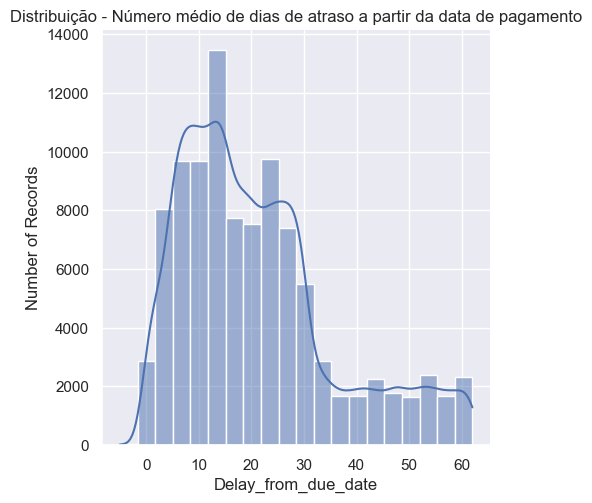

In [77]:
column_name = 'Delay_from_due_date'
group_by = 'Customer_ID'
user_friendly_name = 'Número médio de dias de atraso a partir da data de pagamento'

#Cleaning
clean_numerical_field(df_train,group_by,column_name)

#Plot Graph
plot_displot(df_train,column_name,user_friendly_name)

#### Variável: **Num_of_Delayed_Payment**

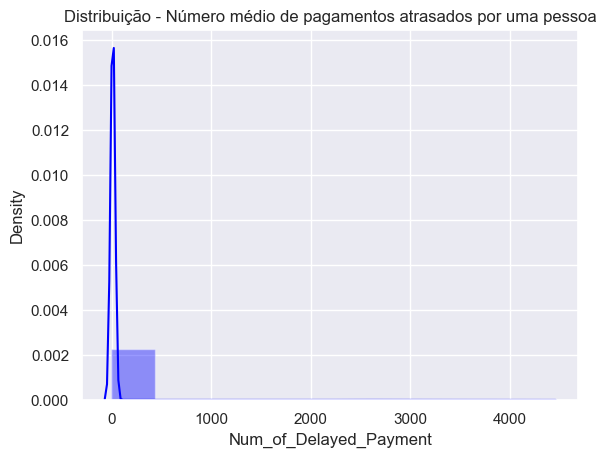

In [78]:
sns.distplot(df_train['Num_of_Delayed_Payment'], kde=True, color='blue', bins = 10)
plt.xlabel('Num_of_Delayed_Payment')
plt.title('Distribuição - Número médio de pagamentos atrasados por uma pessoa')
plt.show()

In [79]:
get_column_details(df_train,'Num_of_Delayed_Payment')

Details of Num_of_Delayed_Payment column

DataType:  int32

There are no null values

Number of Unique Values:  711

Distribution of column:

Num_of_Delayed_Payment
 0       8611
 19      5481
 17      5412
 16      5312
 10      5309
 15      5237
 18      5216
 20      5089
 12      5059
 9       4981
 8       4873
 11      4810
 14      4193
 13      4036
 21      2553
 7       2385
 22      2339
 6       2321
 5       2091
 23      2028
 3       1931
 4       1838
 2       1810
 24      1701
 25      1665
 1       1636
 26       322
-1        316
 27       250
-2        234
 28       131
-3         94
 3484       4
 4211       3
 1946       3
 674        2
 2438       2
 3355       2
 2801       2
 1204       2
 1370       2
 4164       2
 2569       2
 1473       2
 398        2
 3191       2
 2697       2
 2323       2
 192        2
 3251       2
 1014       2
 3050       2
 1849       2
 2142       2
 1180       2
 2793       2
 1150       2
 2621       2
 1392       2
 1087    

In [80]:
unique_Num_of_Delayed_Payment = df_train.groupby('Customer_ID')['Num_of_Delayed_Payment'].nunique()
customer_ids_Num_of_Delayed_Payment = unique_Num_of_Delayed_Payment[unique_Num_of_Delayed_Payment > 1].index
df_Num_of_Delayed_Payment = df_train[df_train['Customer_ID'].isin(customer_ids_Num_of_Delayed_Payment )][['Customer_ID', 'Num_of_Delayed_Payment']]

In [81]:
df_Num_of_Delayed_Payment.head(20)

,Customer_ID,Num_of_Delayed_Payment
0,CUS_0xd40,7
1,CUS_0xd40,0
2,CUS_0xd40,7
3,CUS_0xd40,4
4,CUS_0xd40,0
5,CUS_0xd40,4
6,CUS_0xd40,8
7,CUS_0xd40,6
8,CUS_0x21b1,4
9,CUS_0x21b1,1



-----------------------------------------------------

Cleaning steps 

Existing Min, Max Values:
min      -3
max    4397
Name: Num_of_Delayed_Payment, dtype: int64

After Cleaning Min, Max Values:
min   -2.000
max   28.000
Name: Num_of_Delayed_Payment, dtype: float64

No. of Unique values after Cleaning: 31

No. of Null values after Cleaning: 0

-----------------------------------------------------


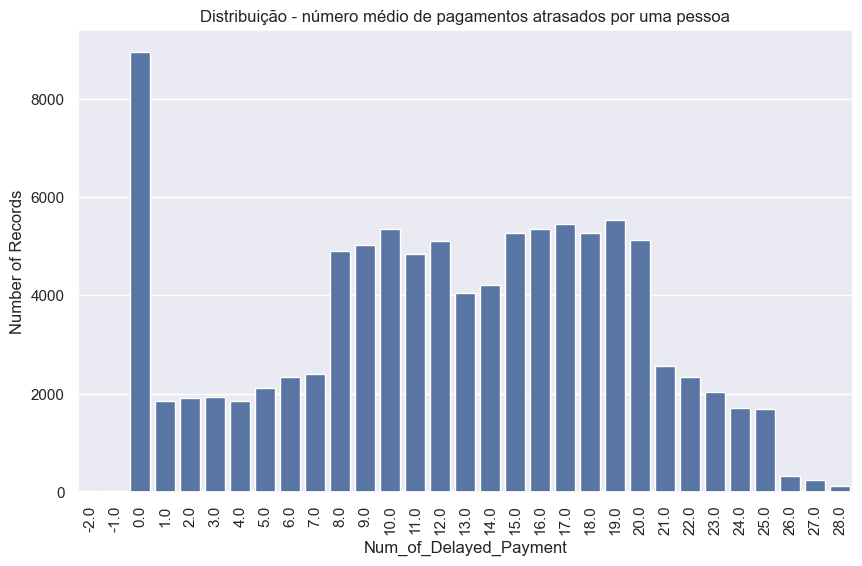

In [82]:
column_name = 'Num_of_Delayed_Payment'
group_by = 'Customer_ID'
user_friendly_name = 'número médio de pagamentos atrasados por uma pessoa'

#Cleaning
clean_numerical_field(df_train,group_by,column_name)
plot_countplot(df_train,column_name,user_friendly_name,rotation=90)

#### Variável: **Changed_Credit_Limit**

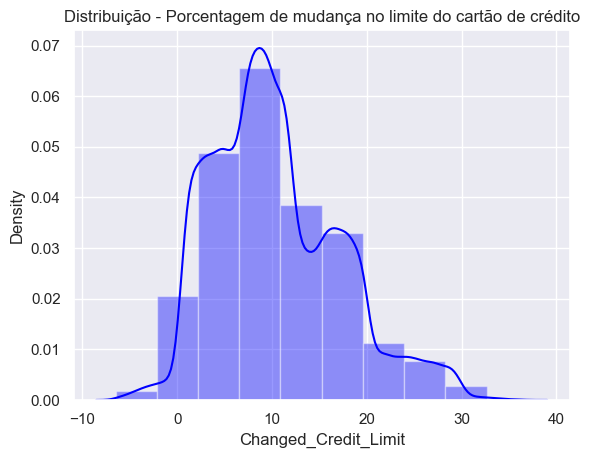

In [83]:
sns.distplot(df_train['Changed_Credit_Limit'], kde=True, color='blue', bins = 10)
plt.xlabel('Changed_Credit_Limit')
plt.title('Distribuição - Porcentagem de mudança no limite do cartão de crédito')
plt.show()

In [84]:
get_column_details(df_train,'Changed_Credit_Limit')

Details of Changed_Credit_Limit column

DataType:  float64

There are  2091  null values

Number of Unique Values:  4383

Distribution of column:

Changed_Credit_Limit
8.220     133
11.500    127
11.320    126
10.060    121
7.350     121
8.230     115
11.490    113
9.250     110
7.330     110
7.690     110
3.930     107
1.630     106
8.300     106
7.010     105
8.760     102
8.990     102
8.540     102
8.040     101
7.230     101
9.200     100
11.730    100
9.880     100
7.630      99
9.580      99
11.950     99
9.130      98
11.780     97
7.910      97
8.820      97
11.630     97
9.970      97
10.540     97
7.060      96
4.920      96
10.300     96
9.090      95
9.180      95
7.640      95
0.570      93
10.470     93
7.660      93
8.740      93
1.590      92
8.670      92
8.070      92
8.950      91
4.010      91
9.660      91
7.980      91
11.510     91
8.720      90
7.750      89
10.360     89
8.560      89
8.940      89
4.860      89
10.640     89
9.920      89
8.340      89
5.990 

In [85]:
unique_Changed_Credit_Limit = df_train.groupby('Customer_ID')['Changed_Credit_Limit'].nunique()
customer_ids_Changed_Credit_Limit= unique_Changed_Credit_Limit[unique_Changed_Credit_Limit > 1].index
df_varied_Changed_Credit_Limit = df_train[df_train['Customer_ID'].isin(customer_ids_Changed_Credit_Limit)][['Customer_ID', 'Changed_Credit_Limit']]

In [86]:
df_varied_Changed_Credit_Limit.head(20)

,Customer_ID,Changed_Credit_Limit
0,CUS_0xd40,11.270
1,CUS_0xd40,11.270
2,CUS_0xd40,NaN
3,CUS_0xd40,6.270
4,CUS_0xd40,11.270
5,CUS_0xd40,9.270
6,CUS_0xd40,11.270
7,CUS_0xd40,11.270
8,CUS_0x21b1,5.420
9,CUS_0x21b1,7.420



-----------------------------------------------------

Cleaning steps 

Existing Min, Max Values:
min   -6.490
max   36.970
Name: Changed_Credit_Limit, dtype: float64

After Cleaning Min, Max Values:
min   -5.010
max   29.980
Name: Changed_Credit_Limit, dtype: float64

No. of Unique values after Cleaning: 3532

No. of Null values after Cleaning: 0

-----------------------------------------------------


<Figure size 1000x600 with 0 Axes>

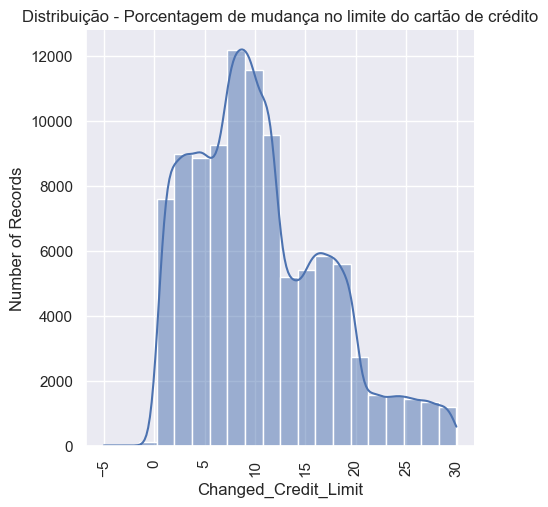

In [87]:
column_name = 'Changed_Credit_Limit'
group_by = 'Customer_ID'
user_friendly_name = 'Porcentagem de mudança no limite do cartão de crédito'

#Cleaning
clean_numerical_field(df_train,group_by,column_name)

#Plot Graph
plot_displot(df_train,column_name,user_friendly_name,rotation=90)

#### Variável: **Num_Credit_Inquiries**

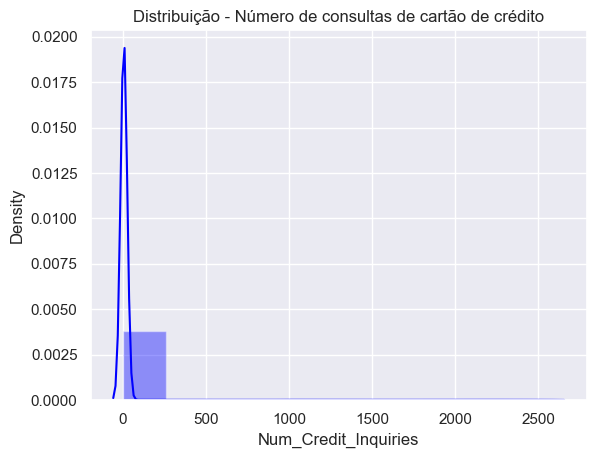

In [88]:
sns.distplot(df_train['Num_Credit_Inquiries'], kde=True, color='blue', bins = 10)
plt.xlabel('Num_Credit_Inquiries')
plt.title('Distribuição - Número de consultas de cartão de crédito')
plt.show()

In [89]:
get_column_details(df_train,'Num_Credit_Inquiries')

Details of Num_Credit_Inquiries column

DataType:  float64

There are  1965  null values

Number of Unique Values:  1223

Distribution of column:

Num_Credit_Inquiries
4.000       11271
3.000        8890
6.000        8111
7.000        8058
2.000        8028
8.000        7866
1.000        7588
0.000        6972
5.000        5693
9.000        5283
11.000       5051
10.000       4936
12.000       4571
13.000       1480
14.000       1039
15.000        808
16.000        456
17.000        284
53.000          4
31.000          4
1114.000        4
1786.000        4
318.000         4
1622.000        4
1230.000        4
1768.000        4
1460.000        4
2297.000        4
2310.000        4
1244.000        4
285.000         4
757.000         3
1175.000        3
2362.000        3
692.000         3
1387.000        3
1890.000        3
2081.000        3
2241.000        3
1497.000        3
2190.000        3
1203.000        3
2022.000        3
1029.000        3
2141.000        3
473.000         3
2199

In [90]:
unique_Num_Credit_Inquiries = df_train.groupby('Customer_ID')['Num_Credit_Inquiries'].nunique()
customer_ids_Num_Credit_Inquiries = unique_Num_Credit_Inquiries[unique_Num_Credit_Inquiries > 1].index
df_varied_Num_Credit_Inquiries = df_train[df_train['Customer_ID'].isin(customer_ids_Num_Credit_Inquiries)][['Customer_ID', 'Num_Credit_Inquiries']]

In [91]:
df_varied_Num_Credit_Inquiries.head(20)

,Customer_ID,Num_Credit_Inquiries
48,CUS_0x284a,2.000
49,CUS_0x284a,4.000
50,CUS_0x284a,4.000
51,CUS_0x284a,4.000
52,CUS_0x284a,4.000
53,CUS_0x284a,4.000
54,CUS_0x284a,4.000
55,CUS_0x284a,4.000
56,CUS_0x5407,5.000
57,CUS_0x5407,5.000



-----------------------------------------------------

Cleaning steps 

Existing Min, Max Values:
min      0.000
max   2597.000
Name: Num_Credit_Inquiries, dtype: float64

After Cleaning Min, Max Values:
min    0.000
max   17.000
Name: Num_Credit_Inquiries, dtype: float64

No. of Unique values after Cleaning: 18

No. of Null values after Cleaning: 0

-----------------------------------------------------


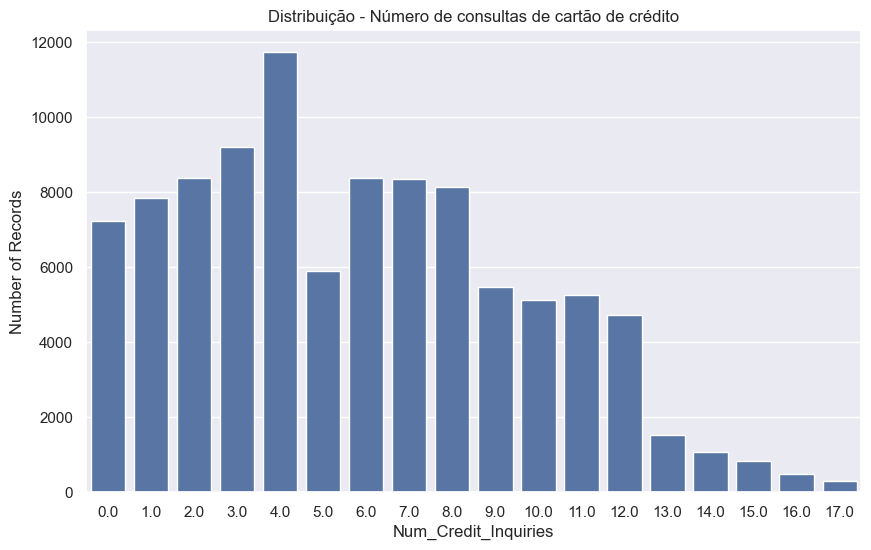

In [92]:
column_name = 'Num_Credit_Inquiries'
group_by = 'Customer_ID'
user_friendly_name = 'Número de consultas de cartão de crédito'

#Cleaning
clean_numerical_field(df_train,group_by,column_name)

#Plot Graph
plot_countplot(df_train,column_name,user_friendly_name)

#### Variável: **Outstanding_Debt**

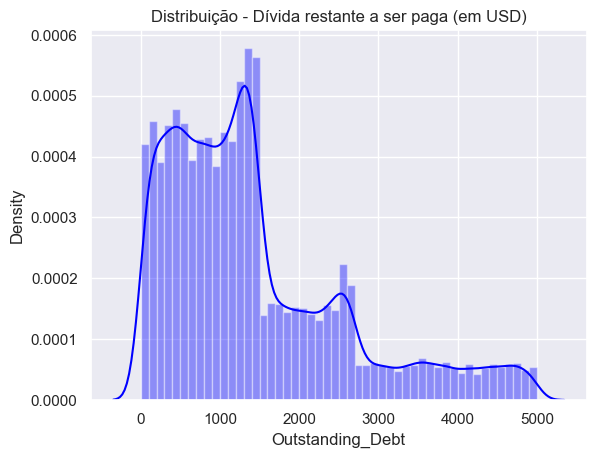

In [93]:
sns.distplot(df_train['Outstanding_Debt'], kde=True, color='blue')
plt.xlabel('Outstanding_Debt')
plt.title('Distribuição - Dívida restante a ser paga (em USD)')
plt.show()

In [94]:
get_column_details(df_train,'Outstanding_Debt')

Details of Outstanding_Debt column

DataType:  float64

There are no null values

Number of Unique Values:  12203

Distribution of column:

Outstanding_Debt
1109.030    24
1151.700    24
1360.450    24
460.460     24
1058.130    16
1466.970    16
328.810     16
198.060     16
762.580     16
330.980     16
227.120     16
1224.880    16
1612.700    16
1124.020    16
1459.050    16
824.360     16
954.650     16
1274.120    16
3628.500    16
1406.850    16
434.360     16
100.300     16
1075.840    16
64.650      16
407.800     16
993.170     16
1334.810    16
6.410       16
55.460      16
55.200      16
1961.730    16
51.500      16
1055.320    16
585.770     16
446.310     16
901.520     16
1462.950    16
395.460     16
1075.370    16
2646.000    16
2538.810    16
1478.070    16
83.550      16
1329.590    16
1154.860    16
2196.590    16
1475.300    16
1803.180    16
494.310     16
176.430     16
579.470     16
1353.860    16
233.760     16
715.370     16
1132.460    16
314.580     16
478


-----------------------------------------------------

Cleaning steps 

Datatype of Outstanding_Debt is changed to <class 'float'>

Existing Min, Max Values:
min      0.230
max   4998.070
Name: Outstanding_Debt, dtype: float64

After Cleaning Min, Max Values:
min      0.230
max   4998.070
Name: Outstanding_Debt, dtype: float64

No. of Unique values after Cleaning: 12203

No. of Null values after Cleaning: 0

-----------------------------------------------------


<Figure size 1000x600 with 0 Axes>

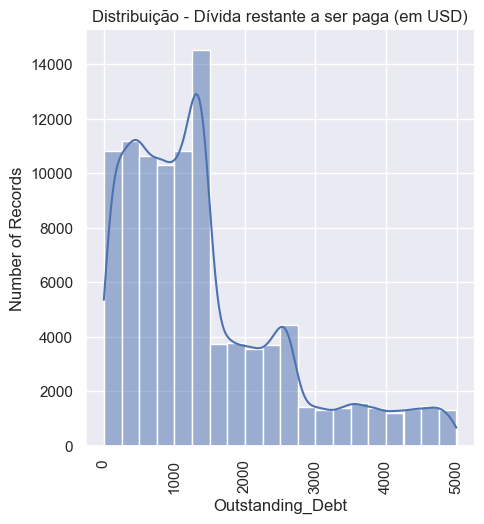

In [95]:
column_name = 'Outstanding_Debt'
group_by = 'Customer_ID'
user_friendly_name = 'Dívida restante a ser paga (em USD)'

#Cleaning
clean_numerical_field(df_train,group_by,column_name,strip='_',datatype=float)

#Plot Graph
plot_displot(df_train,column_name,user_friendly_name,rotation=90)

#### Variável: **Num_Bank_Accounts**

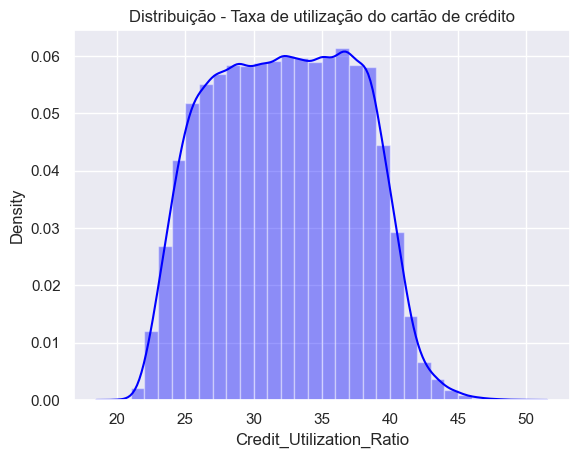

In [96]:
sns.distplot(df_train['Credit_Utilization_Ratio'], kde=True, color='blue', bins = 30)
plt.xlabel('Credit_Utilization_Ratio')
plt.title('Distribuição - Taxa de utilização do cartão de crédito')
plt.show()

In [97]:
get_column_details(df_train,'Credit_Utilization_Ratio')

Details of Credit_Utilization_Ratio column

DataType:  float64

There are no null values

Number of Unique Values:  100000

Distribution of column:

Credit_Utilization_Ratio
26.823    1
28.328    1
30.017    1
25.479    1
33.934    1
30.381    1
34.879    1
36.526    1
33.109    1
37.090    1
39.168    1
36.893    1
30.462    1
23.661    1
25.503    1
30.736    1
27.551    1
33.079    1
28.309    1
31.921    1
29.325    1
34.981    1
33.980    1
27.626    1
25.210    1
27.801    1
40.462    1
27.346    1
34.308    1
36.644    1
30.241    1
32.004    1
31.933    1
27.359    1
23.559    1
26.311    1
35.345    1
35.460    1
37.842    1
30.807    1
35.639    1
28.295    1
34.672    1
41.614    1
27.717    1
36.493    1
30.495    1
32.587    1
26.713    1
35.916    1
24.247    1
27.260    1
36.699    1
36.951    1
31.755    1
36.038    1
34.298    1
32.449    1
23.182    1
32.616    1
33.628    1
26.835    1
35.280    1
38.474    1
34.475    1
34.908    1
35.036    1
22.962    1
30.641    

In [98]:
unique_Credit_Utilization_Ratio = df_train.groupby('Customer_ID')['Credit_Utilization_Ratio'].nunique()
customer_ids_Credit_Utilization_Ratio = unique_Credit_Utilization_Ratio[unique_Credit_Utilization_Ratio > 1].index
df_varied_Credit_Utilization_Ratio= df_train[df_train['Customer_ID'].isin(customer_ids_Credit_Utilization_Ratio)][['Customer_ID', 'Credit_Utilization_Ratio']]

In [99]:
df_varied_Credit_Utilization_Ratio.head(20)

,Customer_ID,Credit_Utilization_Ratio
0,CUS_0xd40,26.823
1,CUS_0xd40,31.945
2,CUS_0xd40,28.609
3,CUS_0xd40,31.378
4,CUS_0xd40,24.797
5,CUS_0xd40,27.262
6,CUS_0xd40,22.538
7,CUS_0xd40,23.934
8,CUS_0x21b1,24.464
9,CUS_0x21b1,38.551


#### Variável: **Total_EMI_per_month**

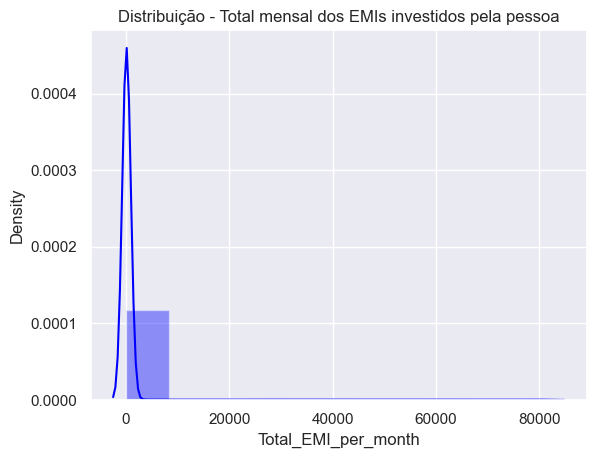

In [100]:
sns.distplot(df_train['Total_EMI_per_month'], kde=True, color='blue', bins=10)
plt.xlabel('Total_EMI_per_month')
plt.title('Distribuição - Total mensal dos EMIs investidos pela pessoa')
plt.show()

In [101]:
get_column_details(df_train,'Total_EMI_per_month')

Details of Total_EMI_per_month column

DataType:  float64

There are no null values

Number of Unique Values:  14950

Distribution of column:

Total_EMI_per_month
0.000        10613
49.575           8
73.533           8
22.961           8
38.661           8
56.977           8
188.272          8
41.902           8
60.817           8
66.783           8
184.378          8
112.394          8
35.371           8
86.822           8
158.607          8
40.105           8
136.293          8
135.357          8
54.010           8
39.177           8
165.773          8
97.583           8
39.583           8
28.832           8
81.716           8
25.473           8
26.495           8
244.985          8
353.616          8
197.322          8
88.647           8
24.703           8
118.140          8
74.738           8
166.091          8
60.768           8
66.558           8
76.284           8
217.653          8
12.241           8
25.957           8
65.274           8
35.499           8
17.059           8
5

In [102]:
unique_Total_EMI_per_month = df_train.groupby('Customer_ID')['Total_EMI_per_month'].nunique()
customer_ids_Total_EMI_per_month = unique_Total_EMI_per_month[unique_Total_EMI_per_month > 1].index
df_varied_Total_EMI_per_month = df_train[df_train['Customer_ID'].isin(customer_ids_Total_EMI_per_month)][['Customer_ID', 'Total_EMI_per_month']]

In [103]:
df_varied_Total_EMI_per_month.head(20)

,Customer_ID,Total_EMI_per_month
40,CUS_0x95ee,15015.000
41,CUS_0x95ee,0.000
42,CUS_0x95ee,0.000
43,CUS_0x95ee,0.000
44,CUS_0x95ee,0.000
45,CUS_0x95ee,15515.000
46,CUS_0x95ee,0.000
47,CUS_0x95ee,0.000
48,CUS_0x284a,137.645
49,CUS_0x284a,137.645



-----------------------------------------------------

Cleaning steps 

Existing Min, Max Values:
min       0.000
max   82331.000
Name: Total_EMI_per_month, dtype: float64

After Cleaning Min, Max Values:
min      0.000
max   1779.103
Name: Total_EMI_per_month, dtype: float64

No. of Unique values after Cleaning: 11890

No. of Null values after Cleaning: 0

-----------------------------------------------------


<Figure size 1000x600 with 0 Axes>

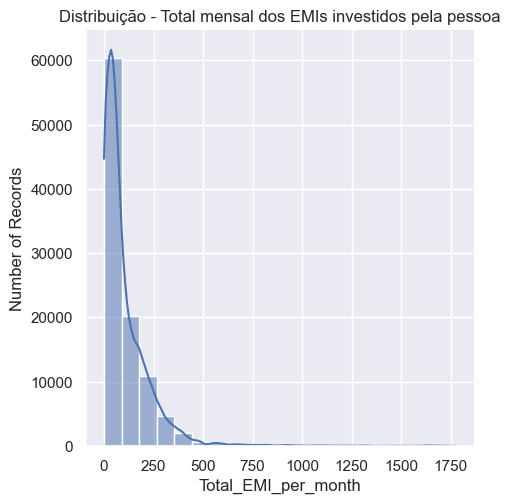

In [104]:
column_name = 'Total_EMI_per_month'
group_by = 'Customer_ID'
user_friendly_name = 'Total mensal dos EMIs investidos pela pessoa'

#Cleaning
clean_numerical_field(df_train,group_by,column_name)

#Plot Graph
plot_displot(df_train,column_name,user_friendly_name)

#### Variável: **Amount_invested_monthly**

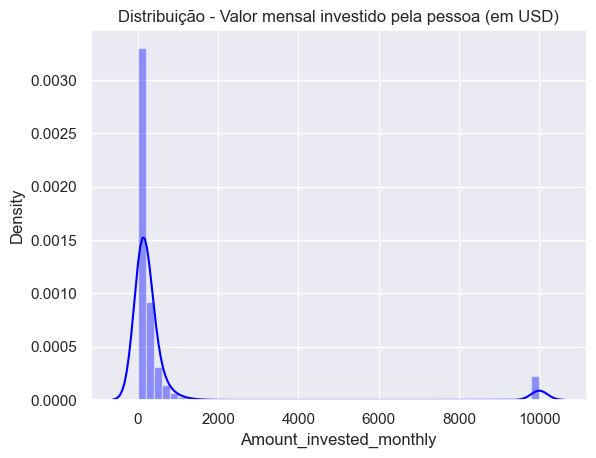

In [105]:
sns.distplot(df_train['Amount_invested_monthly'], kde=True, color='blue')
plt.xlabel('Amount_invested_monthly')
plt.title('Distribuição - Valor mensal investido pela pessoa (em USD)')
plt.show()

In [106]:
get_column_details(df_train,'Amount_invested_monthly')

Details of Amount_invested_monthly column

DataType:  float64

There are  4479  null values

Number of Unique Values:  91049

Distribution of column:

Amount_invested_monthly
10000.000    4305
0.000         169
80.415          1
36.662          1
89.738          1
59.937          1
165.181         1
62.031          1
215.577         1
44.611          1
195.594         1
131.028         1
189.419         1
90.654          1
219.027         1
260.110         1
351.726         1
75.759          1
81.773          1
189.979         1
318.112         1
65.786          1
281.423         1
27.152          1
117.011         1
102.771         1
56.845          1
274.903         1
250.369         1
210.404         1
144.414         1
49.738          1
14.954          1
121.049         1
73.611          1
34.009          1
59.262          1
72.564          1
162.193         1
110.635         1
524.144         1
565.405         1
343.750         1
554.973         1
221.065         1
56.217         

In [107]:
unique_Amount_invested_monthly = df_train.groupby('Customer_ID')['Amount_invested_monthly'].nunique()
customer_ids_Amount_invested_monthly = unique_Amount_invested_monthly[unique_Amount_invested_monthly > 1].index
df_varied_Amount_invested_monthly = df_train[df_train['Customer_ID'].isin(customer_ids_Amount_invested_monthly)][['Customer_ID', 'Amount_invested_monthly']]

In [108]:
df_varied_Amount_invested_monthly.head(20)

,Customer_ID,Amount_invested_monthly
0,CUS_0xd40,80.415
1,CUS_0xd40,118.280
2,CUS_0xd40,81.700
3,CUS_0xd40,199.458
4,CUS_0xd40,41.420
5,CUS_0xd40,62.430
6,CUS_0xd40,178.344
7,CUS_0xd40,24.785
8,CUS_0x21b1,104.292
9,CUS_0x21b1,40.391



-----------------------------------------------------

Cleaning steps 

Existing Min, Max Values:
min       0.000
max   10000.000
Name: Amount_invested_monthly, dtype: float64

After Cleaning Min, Max Values:
min       0.000
max   10000.000
Name: Amount_invested_monthly, dtype: float64

No. of Unique values after Cleaning: 91049

No. of Null values after Cleaning: 0

-----------------------------------------------------


<Figure size 1000x600 with 0 Axes>

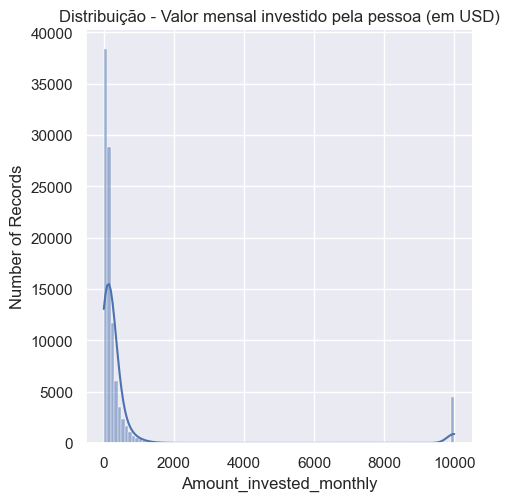

In [109]:
column_name = 'Amount_invested_monthly'
group_by = 'Customer_ID'
user_friendly_name = 'Valor mensal investido pela pessoa (em USD)'

#Cleaning
clean_numerical_field(df_train,group_by,column_name)

#Plot Graph
plot_displot(df_train,column_name,user_friendly_name,bins=100)

#### Variável: **Monthly_Balance**

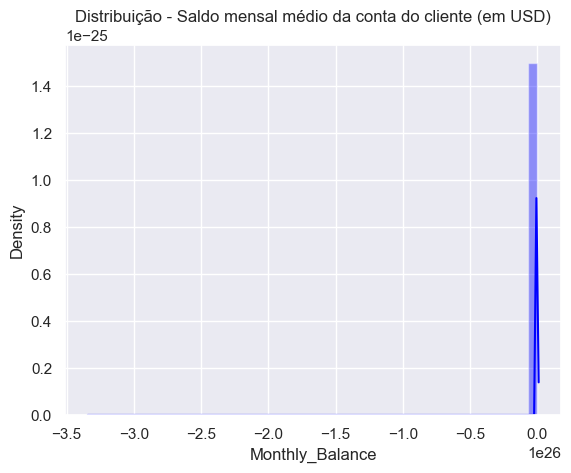

In [110]:
sns.distplot(df_train['Monthly_Balance'], kde=True, color='blue')
plt.xlabel('Monthly_Balance')
plt.title('Distribuição - Saldo mensal médio da conta do cliente (em USD)')
plt.show()

In [111]:
get_column_details(df_train,'Monthly_Balance')

Details of Monthly_Balance column

DataType:  float64

There are  1200  null values

Number of Unique Values:  98792

Distribution of column:

Monthly_Balance
-333333333333333314856026112.000    9
312.494                             1
415.325                             1
252.085                             1
254.971                             1
250.093                             1
289.755                             1
260.626                             1
606.830                             1
111.991                             1
299.545                             1
559.541                             1
604.340                             1
347.414                             1
589.699                             1
486.017                             1
281.884                             1
299.873                             1
318.934                             1
319.976                             1
342.895                             1
335.569                             1
305.3


-----------------------------------------------------

Cleaning steps 

Datatype of Monthly_Balance is changed to float

Existing Min, Max Values:
min      0.008
max   1602.041
Name: Monthly_Balance, dtype: float64

After Cleaning Min, Max Values:
min      0.008
max   1183.931
Name: Monthly_Balance, dtype: float64

No. of Unique values after Cleaning: 98068

No. of Null values after Cleaning: 0

-----------------------------------------------------


<Figure size 1000x600 with 0 Axes>

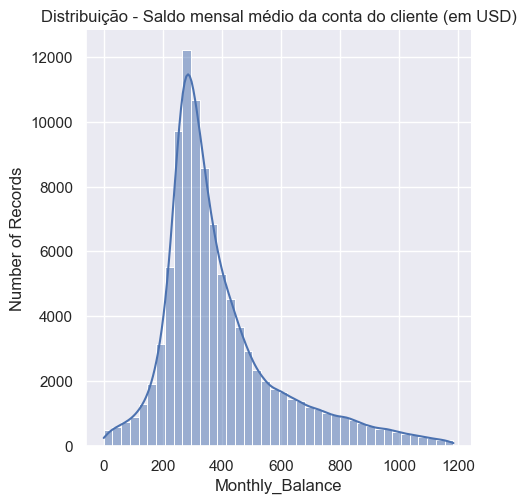

In [112]:
column_name = 'Monthly_Balance'
group_by = 'Customer_ID'
user_friendly_name = 'Saldo mensal médio da conta do cliente (em USD)'

#Cleaning
min_value = df_train[column_name].min()
df_train[column_name].replace(min_value, np.nan, inplace=True)

clean_numerical_field(df_train,group_by,column_name,strip='_',datatype='float')

#Plot Graph
plot_displot(df_train,column_name,user_friendly_name,bins=40)


#### Variável: **Credit_History_Age_MONTH**

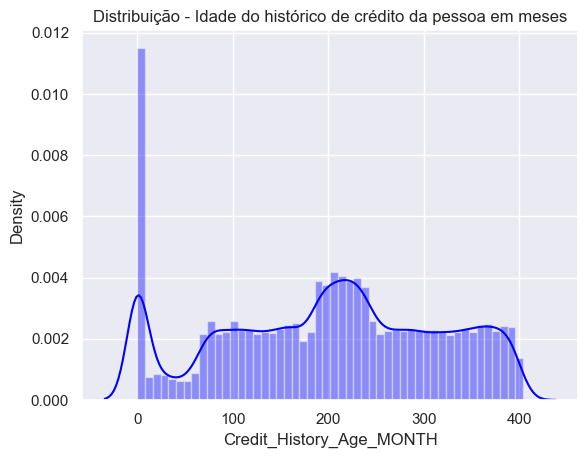

In [113]:
sns.distplot(df_train['Credit_History_Age_MONTH'], kde=True, color='blue')
plt.xlabel('Credit_History_Age_MONTH')
plt.title('Distribuição - Idade do histórico de crédito da pessoa em meses')
plt.show()

In [114]:
unique_Credit_History_Age_MONTH = df_train.groupby('Customer_ID')['Credit_History_Age_MONTH'].nunique()
customer_ids_Credit_History_Age_MONTH = unique_Credit_History_Age_MONTH[unique_Credit_History_Age_MONTH > 1].index
df_Credit_History_Age_MONTH = df_train[df_train['Customer_ID'].isin(customer_ids_Credit_History_Age_MONTH)][['Customer_ID', 'Credit_History_Age_MONTH']]

In [115]:
df_Credit_History_Age_MONTH.head(20)

,Customer_ID,Credit_History_Age_MONTH
0,CUS_0xd40,265
1,CUS_0xd40,0
2,CUS_0xd40,267
3,CUS_0xd40,268
4,CUS_0xd40,269
5,CUS_0xd40,270
6,CUS_0xd40,271
7,CUS_0xd40,0
8,CUS_0x21b1,319
9,CUS_0x21b1,320



-----------------------------------------------------

Cleaning steps 

Datatype of Credit_History_Age_MONTH is changed to float

Existing Min, Max Values:
min     0.000
max   404.000
Name: Credit_History_Age_MONTH, dtype: float64

After Cleaning Min, Max Values:
min     0.000
max   397.000
Name: Credit_History_Age_MONTH, dtype: float64

No. of Unique values after Cleaning: 398

No. of Null values after Cleaning: 0

-----------------------------------------------------


<Figure size 1000x600 with 0 Axes>

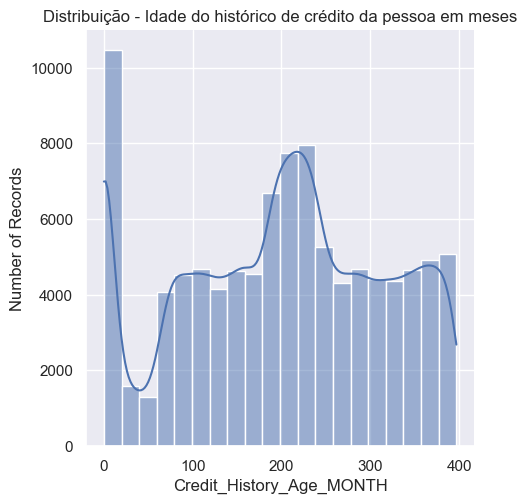

In [116]:
column_name = 'Credit_History_Age_MONTH'
group_by = 'Customer_ID'
user_friendly_name = 'Idade do histórico de crédito da pessoa em meses'

#Cleaning
clean_numerical_field(df_train,group_by,column_name,strip='_',datatype='float')

#Plot Graph
plot_displot(df_train,column_name,user_friendly_name)

## 4. Análise univariada dados categóricos e Feature Engeneering

#### Variável: **Month**

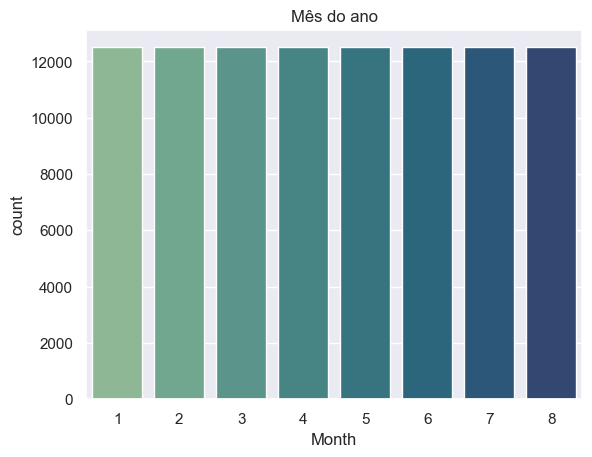

In [117]:
sns.set(style="darkgrid")
sns.countplot(x=df_train['Month'], palette="crest")
plt.title('Mês do ano')
plt.show()

In [118]:
df_train['Month'].value_counts()

Month
1    12500
2    12500
3    12500
4    12500
5    12500
6    12500
7    12500
8    12500
Name: count, dtype: int64

#### Variável: **Occupation**

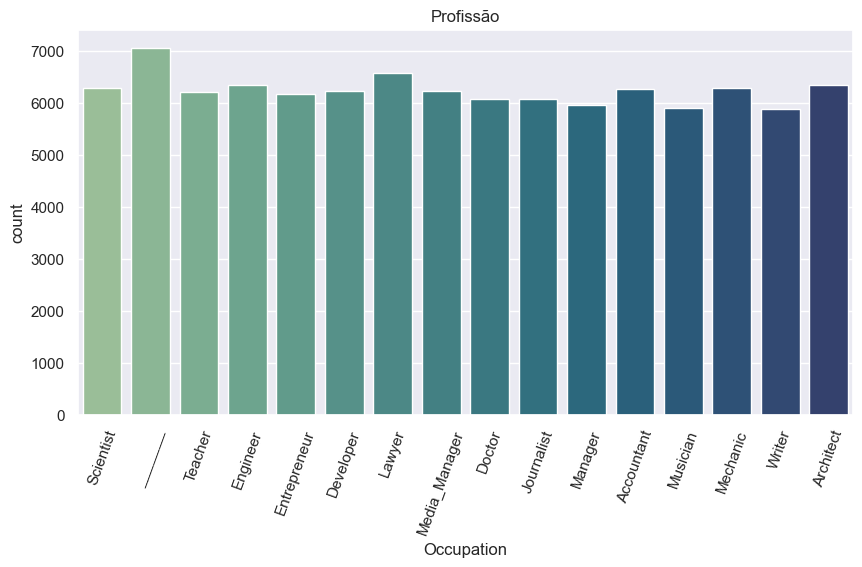

In [119]:
sns.set(style="darkgrid")
plt.figure(figsize=(10, 5))
sns.countplot(x=df_train['Occupation'], palette="crest")
plt.title('Profissão')
plt.xticks(rotation=70)
plt.show()

In [120]:
get_column_details(df_train,'Occupation')

Details of Occupation column

DataType:  object

There are no null values

Number of Unique Values:  16

Distribution of column:

Occupation
_______          7062
Lawyer           6575
Architect        6355
Engineer         6350
Scientist        6299
Mechanic         6291
Accountant       6271
Developer        6235
Media_Manager    6232
Teacher          6215
Entrepreneur     6174
Doctor           6087
Journalist       6085
Manager          5973
Musician         5911
Writer           5885
Name: count, dtype: int64


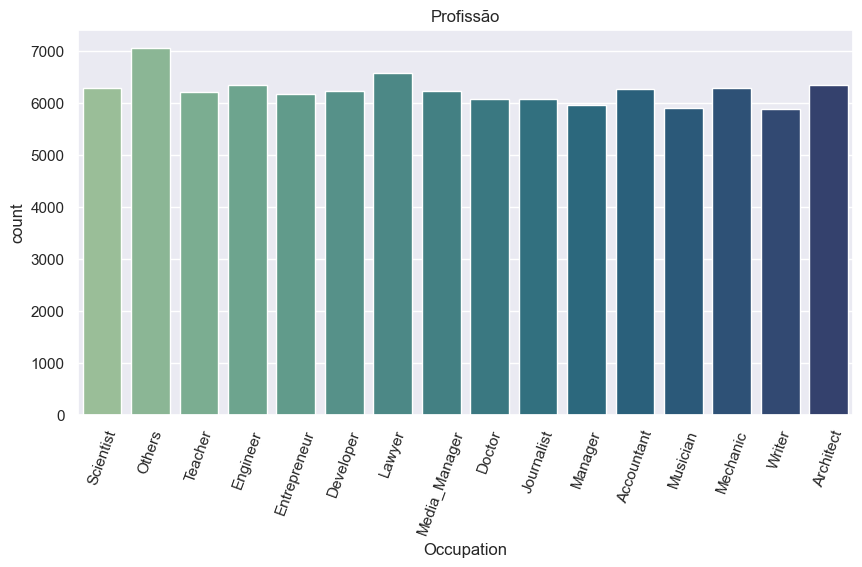

In [121]:
column_name = 'Occupation'
user_friendly_name = 'Profissão'

#Cleaning
df_train[column_name].replace('_______', 'Others', inplace=True)

#Plot Graph
sns.set(style="darkgrid")
plt.figure(figsize=(10, 5))
sns.countplot(x=df_train['Occupation'], palette="crest")
plt.title('Profissão')
plt.xticks(rotation=70)
plt.show()

#### Variável: **SSN**

In [122]:
get_column_details(df_train,'SSN')

Details of SSN column

DataType:  object

There are no null values

Number of Unique Values:  12501

Distribution of column:

SSN
#F%$D@*&8      5572
078-73-5990       8
486-78-3816       8
750-67-7525       8
903-50-0305       8
376-28-6303       8
194-93-5515       8
442-30-8588       8
362-78-8068       8
221-76-9774       8
307-67-5773       8
712-45-6575       8
236-43-2661       8
005-71-5332       8
418-89-9094       8
424-83-6470       8
879-19-2481       8
439-76-5364       8
424-24-7936       8
844-17-9667       8
239-94-3241       8
122-80-2393       8
176-63-8953       8
598-28-8368       8
215-69-1291       8
432-19-3861       8
167-27-0881       8
203-97-2628       8
847-83-6051       8
107-09-2657       8
789-03-7943       8
420-51-6685       8
339-34-1758       8
410-95-7076       8
968-82-9543       8
893-00-5940       8
175-37-1300       8
110-85-1519       8
767-53-7638       8
483-01-4711       8
277-59-7271       8
716-17-7548       8
298-29-8622       8
790-76-976

In [123]:
df_train['SSN'].replace('#F%$D@*&8', np.nan, inplace=True)

In [124]:
get_column_details(df_train,'SSN')

Details of SSN column

DataType:  object

There are  5572  null values

Number of Unique Values:  12500

Distribution of column:

SSN
078-73-5990    8
439-76-5364    8
750-67-7525    8
903-50-0305    8
376-28-6303    8
194-93-5515    8
442-30-8588    8
362-78-8068    8
221-76-9774    8
307-67-5773    8
712-45-6575    8
236-43-2661    8
005-71-5332    8
418-89-9094    8
424-83-6470    8
486-78-3816    8
879-19-2481    8
424-24-7936    8
844-17-9667    8
239-94-3241    8
122-80-2393    8
176-63-8953    8
598-28-8368    8
215-69-1291    8
432-19-3861    8
167-27-0881    8
203-97-2628    8
847-83-6051    8
107-09-2657    8
789-03-7943    8
420-51-6685    8
339-34-1758    8
410-95-7076    8
235-91-8341    8
893-00-5940    8
175-37-1300    8
110-85-1519    8
767-53-7638    8
483-01-4711    8
277-59-7271    8
716-17-7548    8
298-29-8622    8
790-76-9764    8
556-28-1765    8
681-32-9435    8
401-73-3467    8
098-96-4178    8
811-90-5713    8
955-02-8112    8
659-53-9925    8
946-39-9629    8

#### Variável: **Type_of_Loan**

In [125]:
get_column_details(df_train,'Type_of_Loan')

Details of Type_of_Loan column

DataType:  object

There are  11408  null values

Number of Unique Values:  6260

Distribution of column:

Type_of_Loan
Not Specified                                                                                                                                                                             1408
Credit-Builder Loan                                                                                                                                                                       1280
Personal Loan                                                                                                                                                                             1272
Debt Consolidation Loan                                                                                                                                                                   1264
Student Loan                                                                        

In [126]:
df_train['Type_of_Loan'].replace([np.NaN], 'Not Specified', inplace=True)

#### Variável: **Credit_Mix**

In [127]:
get_column_details(df_train,'Credit_Mix')

Details of Credit_Mix column

DataType:  object

There are no null values

Number of Unique Values:  4

Distribution of column:

Credit_Mix
Standard    36479
Good        24337
_           20195
Bad         18989
Name: count, dtype: int64


In [128]:
df_train['Credit_Mix'].replace('_', np.NaN, inplace=True)

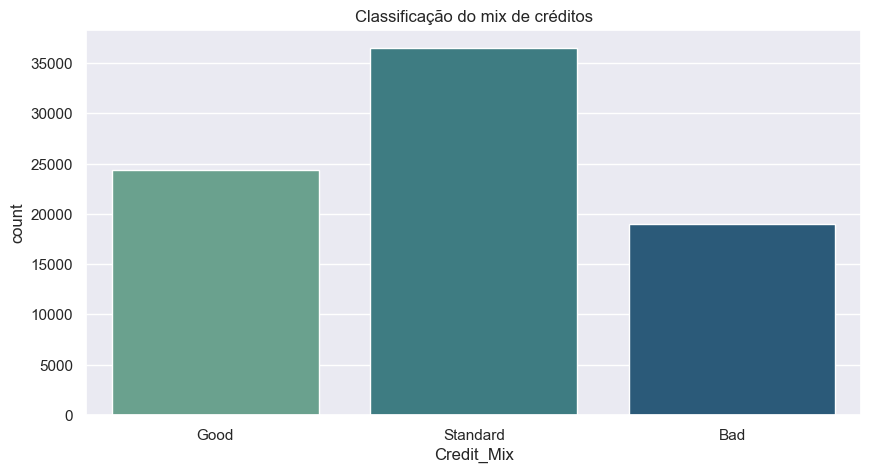

In [129]:
#Plot Graph
sns.set(style="darkgrid")
plt.figure(figsize=(10, 5))
sns.countplot(x=df_train['Credit_Mix'], palette="crest")
plt.title('Classificação do mix de créditos')
plt.show()

#### Variável: **Payment_of_Min_Amount**

In [130]:
column_name = 'Payment_of_Min_Amount'

#Get Details
get_column_details(df_train,column_name)

Details of Payment_of_Min_Amount column

DataType:  object

There are no null values

Number of Unique Values:  3

Distribution of column:

Payment_of_Min_Amount
Yes    52326
No     35667
NM     12007
Name: count, dtype: int64


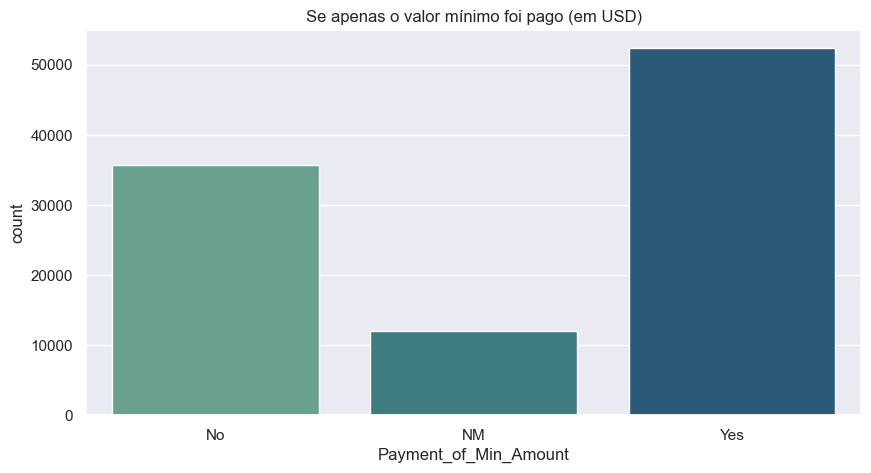

In [131]:
#Plot Graph
sns.set(style="darkgrid")
plt.figure(figsize=(10, 5))
sns.countplot(x=df_train['Payment_of_Min_Amount'], palette="crest")
plt.title('Se apenas o valor mínimo foi pago (em USD)')
plt.show()

#### Variável: **Payment_Behaviour**

In [132]:
column_name = 'Payment_Behaviour'

#Get Details
get_column_details(df_train,column_name)

Details of Payment_Behaviour column

DataType:  object

There are no null values

Number of Unique Values:  7

Distribution of column:

Payment_Behaviour
Low_spent_Small_value_payments      25513
High_spent_Medium_value_payments    17540
Low_spent_Medium_value_payments     13861
High_spent_Large_value_payments     13721
High_spent_Small_value_payments     11340
Low_spent_Large_value_payments      10425
!@9#%8                               7600
Name: count, dtype: int64


In [133]:
df_train['Payment_Behaviour'].replace('!@9#%8', np.NaN, inplace=True)

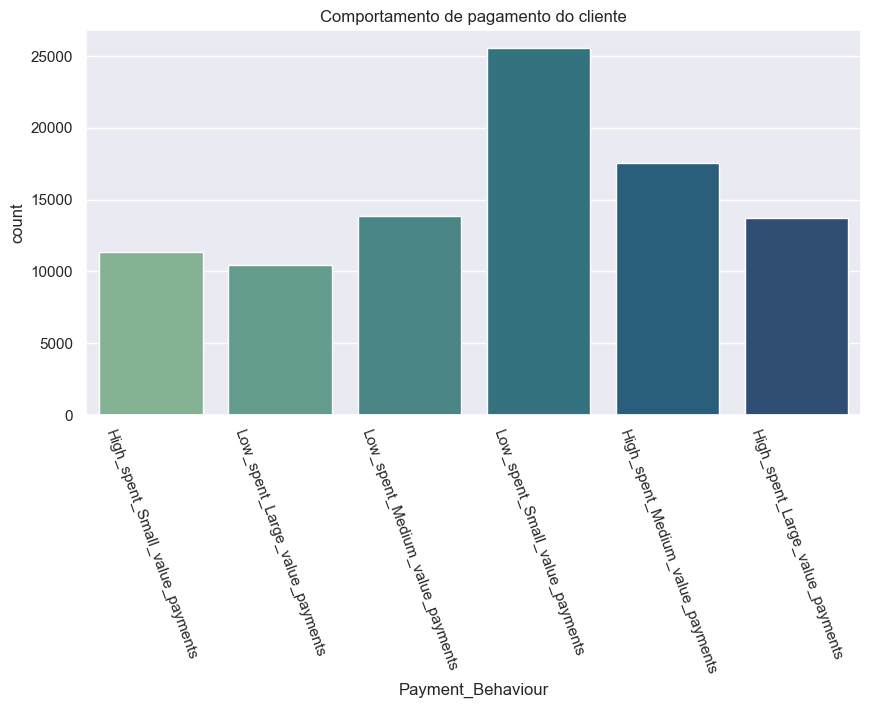

In [134]:
#Plot Graph
sns.set(style="darkgrid")
plt.figure(figsize=(10, 5))
sns.countplot(x=df_train['Payment_Behaviour'], palette="crest")
plt.title('Comportamento de pagamento do cliente')
plt.xticks(rotation=-70)
plt.show()

Retirada das variáveis

In [135]:
colunas_excluir = ['ID', 'Name', 'Customer_ID', 'SSN', 'Credit_History_Age', 'Type_of_Loan']
df_train.drop(colunas_excluir, axis=1, inplace=True)

In [136]:
df_train.dtypes

Month                         int32
Age                         float64
Occupation                   object
Annual_Income               float64
Monthly_Inhand_Salary       float64
Num_Bank_Accounts           float64
Num_Credit_Card             float64
Interest_Rate               float64
Num_of_Loan                 float64
Delay_from_due_date         float64
Num_of_Delayed_Payment      float64
Changed_Credit_Limit        float64
Num_Credit_Inquiries        float64
Credit_Mix                   object
Outstanding_Debt            float64
Credit_Utilization_Ratio    float64
Payment_of_Min_Amount        object
Total_EMI_per_month         float64
Amount_invested_monthly     float64
Payment_Behaviour            object
Monthly_Balance             float64
Credit_Score                 object
Credit_History_Age_MONTH    float64
dtype: object

In [137]:
df_train.describe()

,Month,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Outstanding_Debt,Credit_Utilization_Ratio,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Credit_History_Age_MONTH
count,100000.000,100000.000,100000.000,100000.000,100000.000,100000.000,100000.000,100000.000,100000.000,100000.000,100000.000,100000.000,100000.000,100000.000,100000.000,100000.000,100000.000,100000.000
mean,4.500,33.311,50505.123,4198.351,5.369,5.534,14.532,3.533,21.080,12.392,10.459,5.779,1426.220,32.285,107.506,628.430,394.018,199.948
std,2.291,10.765,38299.422,3187.402,2.593,2.067,8.741,2.446,14.806,6.945,6.622,3.861,1155.129,5.117,131.835,2036.576,201.690,114.297
min,1.000,14.000,7005.930,303.645,0.000,0.000,1.000,0.000,-5.000,-2.000,-5.010,0.000,0.230,20.000,0.000,0.000,0.008,0.000
25%,2.750,24.000,19342.972,1626.762,3.000,4.000,7.000,2.000,10.000,8.000,5.370,3.000,566.072,28.053,29.236,71.022,268.191,113.000
50%,4.500,33.000,36999.705,3095.978,5.000,5.000,13.000,3.000,18.000,13.000,9.400,5.000,1166.155,32.306,66.417,130.572,334.515,208.000
75%,6.250,42.000,71683.470,5961.637,7.000,7.000,20.000,5.000,28.000,18.000,14.850,8.000,1945.963,36.497,147.047,257.063,464.581,291.000
max,8.000,56.000,179987.280,15204.633,10.000,11.000,34.000,9.000,62.000,28.000,29.980,17.000,4998.070,50.000,1779.103,10000.000,1183.931,397.000


In [138]:
missing_values = df_train.isnull().sum().sort_values(ascending = False)
missing_values

Credit_Mix                  20195
Payment_Behaviour            7600
Month                           0
Num_Credit_Inquiries            0
Credit_Score                    0
Monthly_Balance                 0
Amount_invested_monthly         0
Total_EMI_per_month             0
Payment_of_Min_Amount           0
Credit_Utilization_Ratio        0
Outstanding_Debt                0
Changed_Credit_Limit            0
Age                             0
Num_of_Delayed_Payment          0
Delay_from_due_date             0
Num_of_Loan                     0
Interest_Rate                   0
Num_Credit_Card                 0
Num_Bank_Accounts               0
Monthly_Inhand_Salary           0
Annual_Income                   0
Occupation                      0
Credit_History_Age_MONTH        0
dtype: int64

## 5. Tranformações variáveis categóricas em variáveis dummies

In [139]:
df_train = pd.get_dummies(df_train, columns=['Occupation'])
df_train = pd.get_dummies(df_train, columns=['Credit_Mix'])
df_train = pd.get_dummies(df_train, columns=['Payment_Behaviour'])
df_train = pd.get_dummies(df_train, columns=['Payment_of_Min_Amount'])

In [140]:
df_train['Credit_Score'] = df_train['Credit_Score'].str.strip()

In [141]:
df_train['Credit_Score'].value_counts()

Credit_Score
Standard    53174
Poor        28998
Good        17828
Name: count, dtype: int64

In [142]:
score_mapping = {'Good': 1,'Standard': 2,'Poor': 3}
df_train['Credit_Score'] = df_train['Credit_Score'].map(score_mapping)

In [143]:
df_train['Credit_Score'].value_counts()

Credit_Score
2    53174
3    28998
1    17828
Name: count, dtype: int64

In [144]:
credit_score = df_train.pop('Credit_Score')
df_train['Credit_Score'] = credit_score

In [145]:
df_train.dtypes

Month                                                   int32
Age                                                   float64
Annual_Income                                         float64
Monthly_Inhand_Salary                                 float64
Num_Bank_Accounts                                     float64
Num_Credit_Card                                       float64
Interest_Rate                                         float64
Num_of_Loan                                           float64
Delay_from_due_date                                   float64
Num_of_Delayed_Payment                                float64
Changed_Credit_Limit                                  float64
Num_Credit_Inquiries                                  float64
Outstanding_Debt                                      float64
Credit_Utilization_Ratio                              float64
Total_EMI_per_month                                   float64
Amount_invested_monthly                               float64
Monthly_

In [146]:
non_numeric_columns = df_train.select_dtypes(exclude=[np.number]).columns
print(non_numeric_columns)

Index(['Occupation_Accountant', 'Occupation_Architect', 'Occupation_Developer',
       'Occupation_Doctor', 'Occupation_Engineer', 'Occupation_Entrepreneur',
       'Occupation_Journalist', 'Occupation_Lawyer', 'Occupation_Manager',
       'Occupation_Mechanic', 'Occupation_Media_Manager',
       'Occupation_Musician', 'Occupation_Others', 'Occupation_Scientist',
       'Occupation_Teacher', 'Occupation_Writer', 'Credit_Mix_Bad',
       'Credit_Mix_Good', 'Credit_Mix_Standard',
       'Payment_Behaviour_High_spent_Large_value_payments',
       'Payment_Behaviour_High_spent_Medium_value_payments',
       'Payment_Behaviour_High_spent_Small_value_payments',
       'Payment_Behaviour_Low_spent_Large_value_payments',
       'Payment_Behaviour_Low_spent_Medium_value_payments',
       'Payment_Behaviour_Low_spent_Small_value_payments',
       'Payment_of_Min_Amount_NM', 'Payment_of_Min_Amount_No',
       'Payment_of_Min_Amount_Yes'],
      dtype='object')


In [147]:
# Identificando e convertendo colunas booleanas para int
for column in df_train.columns:
    if df_train[column].dtype == 'bool':
        df_train[column] = df_train[column].astype(int)

In [148]:
non_numeric_columns = df_train.select_dtypes(exclude=[np.number]).columns
print(non_numeric_columns)

Index([], dtype='object')


## 6. Análise de Correlação por Pearson

### Correlação com a variável target: Credit_Score

In [149]:
# Coluna de referência para o cálculo do coeficiente de Pearson
coluna_referencia = 'Credit_Score'

resultados_correlacao = {}
resultados_pvalue = {}
colunas_corr = []

# Itere pelas colunas do DataFrame
for coluna in df_train.columns:
    if coluna != coluna_referencia:
        correlacao, p_value = pearsonr(df_train[coluna_referencia], df_train[coluna])
        resultados_correlacao[coluna] = correlacao
        resultados_pvalue[coluna] = p_value

# Exiba os resultados
for coluna, p_value in resultados_pvalue.items():
    if p_value < 0.05:
        colunas_corr.append(coluna)
        print(f"Existe correlação significativa entre 'target' e '{coluna}': Correlação = {resultados_correlacao[coluna]:.4f}, p-valor = {p_value:.4f}")

Existe correlação significativa entre 'target' e 'Month': Correlação = -0.0163, p-valor = 0.0000
Existe correlação significativa entre 'target' e 'Age': Correlação = -0.1603, p-valor = 0.0000
Existe correlação significativa entre 'target' e 'Annual_Income': Correlação = -0.2126, p-valor = 0.0000
Existe correlação significativa entre 'target' e 'Monthly_Inhand_Salary': Correlação = -0.2099, p-valor = 0.0000
Existe correlação significativa entre 'target' e 'Num_Bank_Accounts': Correlação = 0.3882, p-valor = 0.0000
Existe correlação significativa entre 'target' e 'Num_Credit_Card': Correlação = 0.4044, p-valor = 0.0000
Existe correlação significativa entre 'target' e 'Interest_Rate': Correlação = 0.4854, p-valor = 0.0000
Existe correlação significativa entre 'target' e 'Num_of_Loan': Correlação = 0.3584, p-valor = 0.0000
Existe correlação significativa entre 'target' e 'Delay_from_due_date': Correlação = 0.4315, p-valor = 0.0000
Existe correlação significativa entre 'target' e 'Num_of_Del

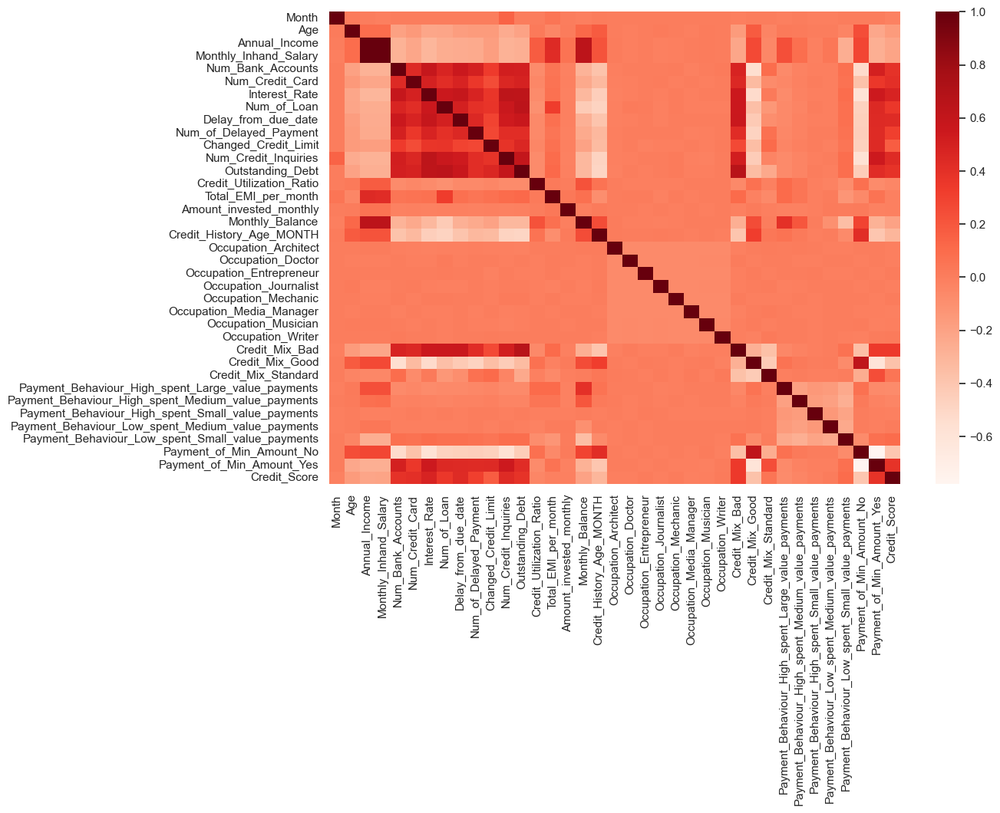

In [150]:
colunas_de_interesse = colunas_corr.copy()
colunas_de_interesse.append('Credit_Score')
df_correlacao = df_train[colunas_de_interesse].corr()

plt.figure(figsize = (12, 8))
# Mapa de calor apenas para as colunas de interesse
# Estamos realçando os valores de correlação entre 0.59 e 0.99, positivo ou negativo.
sns.heatmap(df_correlacao, annot=False, fmt='.3f', cmap='Reds')
plt.show()

## 7. Aplicação dos tratamentos na base de teste

Os mesmos tratamentos de limpeza de dados precisam ser aplicados na base de teste

In [151]:
columns_and_types = {
    'Annual_Income': float,
    'Num_of_Loan': int,
    'Delay_from_due_date': int,
    'Num_of_Delayed_Payment': int,
    'Changed_Credit_Limit': float,
    'Outstanding_Debt': float,
    'Amount_invested_monthly': float,
    'Monthly_Balance': float,
    'Age': int
}

for column, dtype in columns_and_types.items():
    df_test = clean_and_convert_column(df_test, column, dtype)

In [152]:
df_test['Credit_History_Age_MONTH'] = df_test['Credit_History_Age'].apply(convert_to_months)
df_test['Month'] = pd.to_datetime(df_test.Month, format='%B').dt.month

clean_numerical_field(df_test, 'Customer_ID', 'Age' ,strip='_',datatype='int')

clean_numerical_field(df_test,'Customer_ID', 'Annual_Income', strip='_',datatype='float')

clean_numerical_field(df_test, 'Customer_ID', 'Monthly_Inhand_Salary')

clean_numerical_field(df_test, 'Customer_ID', 'Num_Bank_Accounts')
df_test['Num_Bank_Accounts'] = df_test['Num_Bank_Accounts'].replace(-1, 0)

clean_numerical_field(df_test, 'Customer_ID', 'Num_Credit_Card')

clean_numerical_field(df_test, 'Customer_ID', 'Interest_Rate')

clean_numerical_field(df_test, 'Customer_ID', 'Num_of_Loan')

clean_numerical_field(df_test, 'Customer_ID', 'Delay_from_due_date')

clean_numerical_field(df_test, 'Customer_ID', 'Num_of_Delayed_Payment')

clean_numerical_field(df_test, 'Customer_ID', 'Changed_Credit_Limit')

clean_numerical_field(df_test, 'Customer_ID', 'Num_Credit_Inquiries')

clean_numerical_field(df_test, 'Customer_ID', 'Outstanding_Debt', strip='_', datatype=float)

clean_numerical_field(df_test, 'Customer_ID', 'Total_EMI_per_month')

clean_numerical_field(df_test, 'Customer_ID', 'Amount_invested_monthly')


min_value = df_test['Monthly_Balance'].min() ## existem dois valores extremos que estão poluindo o dataframe e por isso esse trecho é executado 2x
df_test['Monthly_Balance'].replace(min_value, np.nan, inplace=True)
min_value = df_test['Monthly_Balance'].min()
df_test['Monthly_Balance'].replace(min_value, np.nan, inplace=True)
clean_numerical_field(df_test, 'Customer_ID', 'Monthly_Balance' , strip='_',datatype='float')

clean_numerical_field(df_test, 'Customer_ID', 'Credit_History_Age_MONTH', strip='_', datatype='float')

df_test['Occupation'].replace('_______', 'Others', inplace=True)
df_test['SSN'].replace('#F%$D@*&8', np.nan, inplace=True)
df_test['Type_of_Loan'].replace([np.NaN], 'Not Specified', inplace=True)
df_test['Credit_Mix'].replace('_', np.NaN, inplace=True)
df_test['Payment_Behaviour'].replace('!@9#%8', np.NaN, inplace=True)

df_test.drop(colunas_excluir, axis=1, inplace=True)


-----------------------------------------------------

Cleaning steps 

Datatype of Age is changed to int

Existing Min, Max Values:
min    -500
max    8688
Name: Age, dtype: int64

After Cleaning Min, Max Values:
min   -500.000
max     56.000
Name: Age, dtype: float64

No. of Unique values after Cleaning: 44

No. of Null values after Cleaning: 0

-----------------------------------------------------

Cleaning steps 

Datatype of Annual_Income is changed to float

Existing Min, Max Values:
min       7005.930
max   24137255.000
Name: Annual_Income, dtype: float64

After Cleaning Min, Max Values:
min     7005.930
max   179987.280
Name: Annual_Income, dtype: float64

No. of Unique values after Cleaning: 12488

No. of Null values after Cleaning: 0

-----------------------------------------------------

Cleaning steps 

Existing Min, Max Values:
min     303.645
max   15204.633
Name: Monthly_Inhand_Salary, dtype: float64

After Cleaning Min, Max Values:
min     303.645
max   15204.633
Name:

In [153]:
df_test.head()

,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_History_Age_MONTH
0,9,23.000,Scientist,19114.120,1824.843,3.000,4.000,3.000,4.000,3.000,7.000,11.270,4.000,Good,809.980,35.030,No,49.575,236.643,Low_spent_Small_value_payments,186.267,273.000
1,10,24.000,Scientist,19114.120,1824.843,3.000,4.000,3.000,4.000,3.000,9.000,13.270,4.000,Good,809.980,33.053,No,49.575,21.465,High_spent_Medium_value_payments,361.444,274.000
2,11,24.000,Scientist,19114.120,1824.843,3.000,4.000,3.000,4.000,3.000,4.000,12.270,4.000,Good,809.980,33.812,No,49.575,148.234,Low_spent_Medium_value_payments,264.675,0.000
3,12,24.000,Scientist,19114.120,1824.843,3.000,4.000,3.000,4.000,4.000,5.000,11.270,4.000,Good,809.980,32.431,No,49.575,39.083,High_spent_Medium_value_payments,343.827,276.000
4,9,28.000,Others,34847.840,3037.987,2.000,4.000,6.000,1.000,3.000,1.000,5.420,5.000,Good,605.030,25.927,No,18.816,39.684,High_spent_Large_value_payments,485.298,327.000


In [154]:
df_test.describe()

,Month,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Outstanding_Debt,Credit_Utilization_Ratio,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Credit_History_Age_MONTH
count,50000.000,50000.000,50000.000,50000.000,50000.000,50000.000,50000.000,50000.000,50000.000,50000.000,50000.000,50000.000,50000.000,50000.000,50000.000,50000.000,50000.000,50000.000
mean,10.500,33.568,50505.123,4181.292,5.369,5.534,14.532,3.107,21.062,12.383,10.446,7.281,1426.220,32.280,124.289,621.096,400.698,206.810
std,1.118,15.711,38299.614,3173.165,2.595,2.072,8.741,7.067,14.808,6.957,6.664,3.956,1155.135,5.106,165.636,2018.198,210.914,115.017
min,9.000,-500.000,7005.930,303.645,0.000,0.000,1.000,-100.000,-5.000,-3.000,-6.280,0.000,0.230,20.510,0.000,0.000,0.256,0.000
25%,9.750,25.000,19342.972,1623.584,3.000,4.000,7.000,2.000,10.000,8.000,5.360,4.000,566.072,28.061,31.199,72.513,269.637,121.000
50%,10.500,33.000,36999.705,3083.893,5.000,5.000,13.000,3.000,18.000,13.000,9.410,7.000,1166.155,32.280,71.667,132.153,336.252,215.000
75%,11.250,42.000,71683.470,5936.447,7.000,7.000,20.000,5.000,28.000,18.000,14.800,10.000,1945.963,36.469,163.334,258.987,469.549,298.000
max,12.000,56.000,179987.280,15204.633,11.000,11.000,34.000,9.000,62.000,28.000,34.210,17.000,4998.070,48.541,1779.103,10000.000,1348.683,405.000


In [155]:
df_test = pd.get_dummies(df_test, columns=['Occupation'])
df_test = pd.get_dummies(df_test, columns=['Credit_Mix'])
df_test = pd.get_dummies(df_test, columns=['Payment_Behaviour'])
df_test = pd.get_dummies(df_test, columns=['Payment_of_Min_Amount'])

In [156]:
# Identificando e convertendo colunas booleanas para int
for column in df_test.columns:
    if df_test[column].dtype == 'bool':
        df_test[column] = df_test[column].astype(int)

In [157]:
df_test_selection = df_test[colunas_corr]

## 8. Construção dos Modelos

In [158]:
df_train_selection = df_train[colunas_de_interesse].copy()

In [159]:
df_train_selection.head()

,Month,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Outstanding_Debt,Credit_Utilization_Ratio,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Credit_History_Age_MONTH,Occupation_Architect,Occupation_Doctor,Occupation_Entrepreneur,Occupation_Journalist,Occupation_Mechanic,Occupation_Media_Manager,Occupation_Musician,Occupation_Writer,Credit_Mix_Bad,Credit_Mix_Good,Credit_Mix_Standard,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Credit_Score
0,1,23.000,19114.120,1824.843,3.000,4.000,3.000,4.000,3.000,7.000,11.270,4.000,809.980,26.823,49.575,80.415,312.494,265.000,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1
1,2,23.000,19114.120,1824.843,3.000,4.000,3.000,4.000,3.000,0.000,11.270,4.000,809.980,31.945,49.575,118.280,284.629,0.000,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1
2,3,23.000,19114.120,1824.843,3.000,4.000,3.000,4.000,3.000,7.000,11.270,4.000,809.980,28.609,49.575,81.700,331.210,267.000,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,1
3,4,23.000,19114.120,1824.843,3.000,4.000,3.000,4.000,5.000,4.000,6.270,4.000,809.980,31.378,49.575,199.458,223.451,268.000,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,0,1
4,5,23.000,19114.120,1824.843,3.000,4.000,3.000,4.000,6.000,0.000,11.270,4.000,809.980,24.797,49.575,41.420,341.489,269.000,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,1


In [160]:
def evaluate_model(model, X_train, y_train, X_test, y_test):
    model_name = model.__class__.__name__
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # Calculando a matriz de confusão
    conf_matrix = confusion_matrix(y_test, y_pred)

    # Plotando a matriz de confusão
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt='g', cmap='Blues')
    plt.title(f'Matriz de Confusão para {model_name}')
    plt.xlabel('Predições')
    plt.ylabel('Valores Reais')
    plt.show()

    # Calculando outras métricas de desempenho
    accuracy = accuracy_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred, average='macro')
    precision = precision_score(y_test, y_pred, average='macro')
    f1 = f1_score(y_test, y_pred, average='macro')

    # Imprimindo resultados
    print(f'Modelo: {model_name}')
    print(f'Acurácia: {accuracy:.3f}')
    print(f'Recall: {recall:.3f}')
    print(f'Precisão: {precision:.3f}')
    print(f'F1 Score: {f1:.3f}\n')

    return {
        'model': model_name,
        'confusion_matrix': conf_matrix,
        'accuracy': accuracy,
        'recall': recall,
        'precision': precision,
        'f1_score': f1
    }


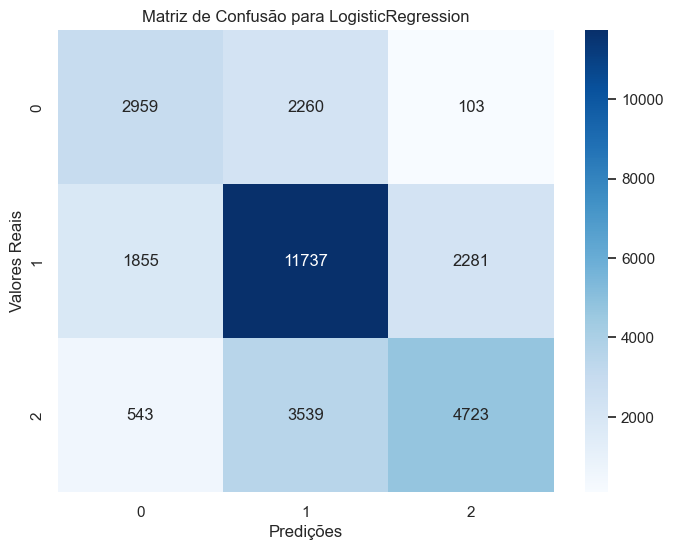

Modelo: LogisticRegression
Acurácia: 0.647
Recall: 0.611
Precisão: 0.629
F1 Score: 0.617



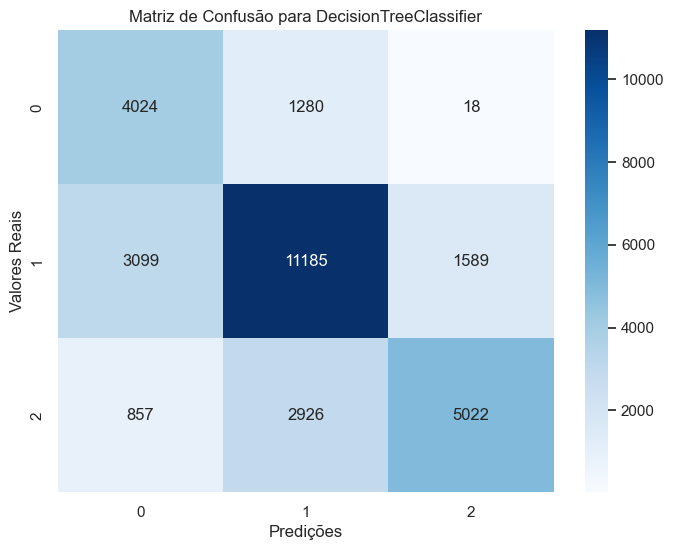

Modelo: DecisionTreeClassifier
Acurácia: 0.674
Recall: 0.677
Precisão: 0.663
F1 Score: 0.657



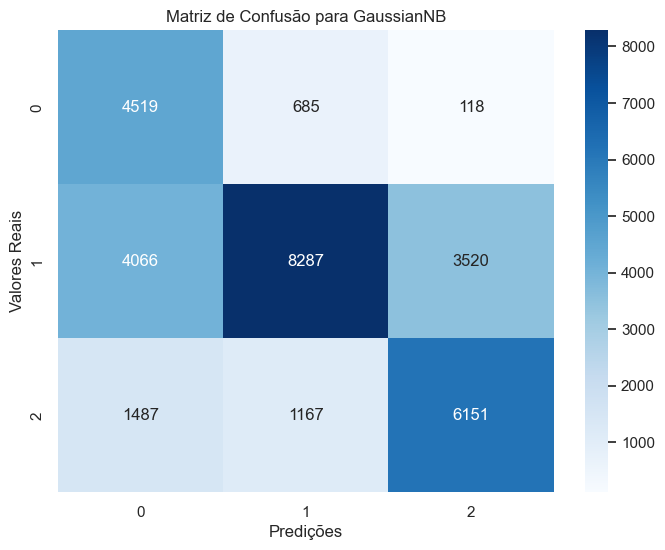

Modelo: GaussianNB
Acurácia: 0.632
Recall: 0.690
Precisão: 0.631
F1 Score: 0.629



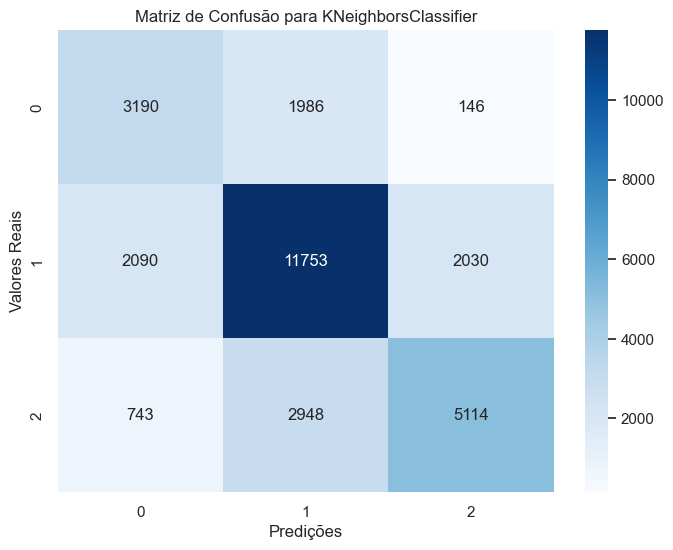

Modelo: KNeighborsClassifier
Acurácia: 0.669
Recall: 0.640
Precisão: 0.645
F1 Score: 0.640



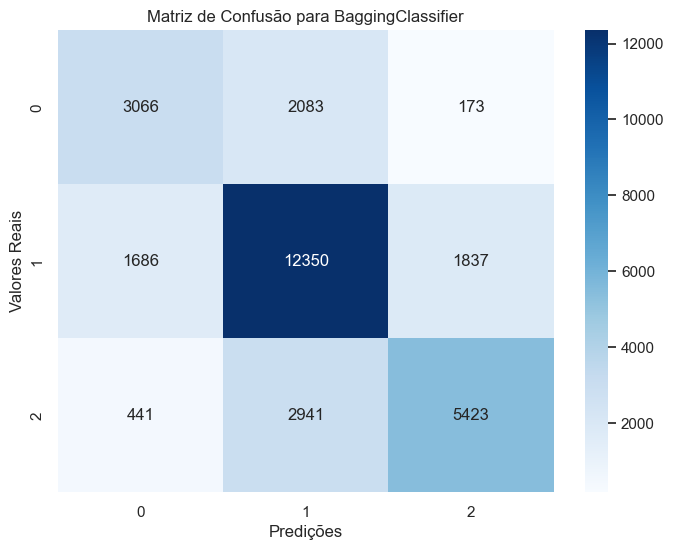

Modelo: BaggingClassifier
Acurácia: 0.695
Recall: 0.657
Precisão: 0.677
F1 Score: 0.665



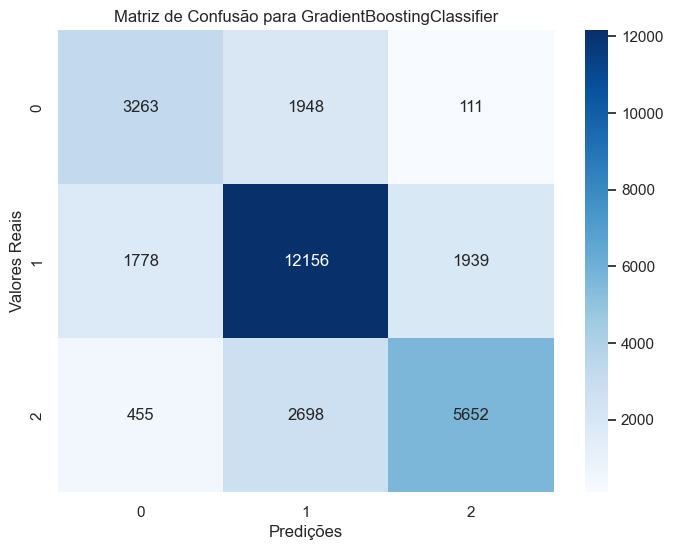

Modelo: GradientBoostingClassifier
Acurácia: 0.702
Recall: 0.674
Precisão: 0.684
F1 Score: 0.677

__________________________________________________________________
MELHOR MODELO:
Modelo: GradientBoostingClassifier
Matriz de Confusão: 
[[ 3263  1948   111]
 [ 1778 12156  1939]
 [  455  2698  5652]]
Acurácia: 0.702
Recall: 0.674
Precisão: 0.684
F1 Score: 0.677


In [161]:
df = df_train_selection
target = 'Credit_Score'
X = df.drop(target, axis=1)
y = df[target]

# Dividindo os dados em conjuntos de treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Normalizando os dados
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Lista de modelos com variação de parâmetros
models = [
    LogisticRegression(max_iter=1000, C=0.5),
    DecisionTreeClassifier(max_depth=5, min_samples_split=10),
    GaussianNB(var_smoothing=1e-9),
    KNeighborsClassifier(n_neighbors=5, metric='minkowski'),
    #SVC(C=1.0, kernel='rbf'),
    BaggingClassifier(base_estimator=DecisionTreeClassifier(max_depth=5), n_estimators=10, max_samples=0.5),
    GradientBoostingClassifier(n_estimators=100, learning_rate=0.1)
]

# Avaliando cada modelo
results = []
for model in models:
    results.append(evaluate_model(model, X_train_scaled, y_train, X_test_scaled, y_test))

# Encontrando o melhor modelo com base na acurácia
best_model = max(results, key=lambda x: x['accuracy'])
print("__________________________________________________________________")
print("MELHOR MODELO:")
print(f"Modelo: {best_model['model']}")
print(f"Matriz de Confusão: \n{best_model['confusion_matrix']}")
print(f"Acurácia: {best_model['accuracy']:.3f}")
print(f"Recall: {best_model['recall']:.3f}")
print(f"Precisão: {best_model['precision']:.3f}")
print(f"F1 Score: {best_model['f1_score']:.3f}")

In [162]:
from sklearn.cluster import KMeans

features = df_train_selection.drop('Credit_Score', axis=1)

scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

# Número de clusters
n_clusters = 3

# Criando e treinando o modelo KMeans
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
kmeans.fit(features_scaled)

# Atribuindo os clusters aos dados
df_train_selection['predicted_credit_Score'] = kmeans.labels_ + 1

# Comparando os rótulos reais com os clusters previstos
comparison = df_train_selection[['Credit_Score', 'predicted_credit_Score']]
print(comparison)


       Credit_Score  predicted_credit_Score
0                 1                       2
1                 1                       2
2                 1                       2
3                 1                       2
4                 1                       2
5                 1                       2
6                 1                       2
7                 2                       2
8                 2                       2
9                 1                       2
10                2                       2
11                1                       2
12                1                       2
13                1                       2
14                1                       2
15                1                       2
16                1                       2
17                1                       2
18                1                       2
19                1                       2
20                1                       2
21                1             

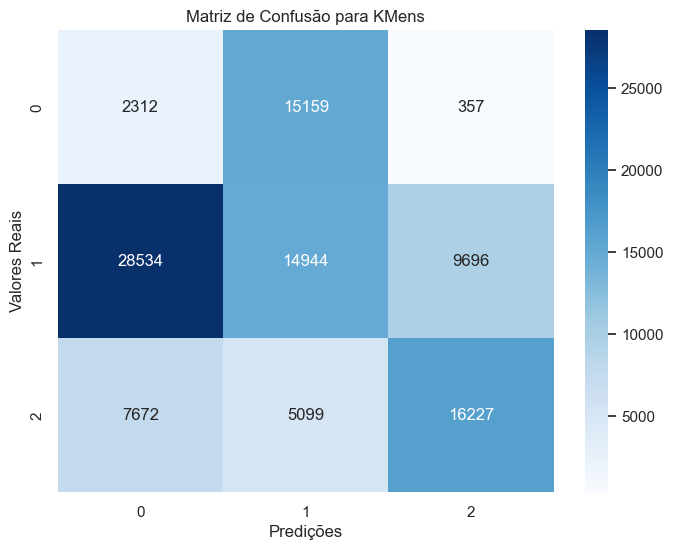

In [165]:
conf_matrix = confusion_matrix(df_train_selection['Credit_Score'], df_train_selection['predicted_credit_Score'])

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='g', cmap='Blues')
plt.title(f'Matriz de Confusão para KMens')
plt.xlabel('Predições') 
plt.ylabel('Valores Reais')
plt.show()

In [170]:
accuracy = accuracy_score(df_train_selection['Credit_Score'], df_train_selection['predicted_credit_Score'])

accuracy

0.33483

In [166]:
df_train_selection['Credit_Score'].value_counts()

Credit_Score
2    53174
3    28998
1    17828
Name: count, dtype: int64

In [167]:
df_train_selection['predicted_credit_Score'].value_counts()

predicted_credit_Score
1    38518
2    35202
3    26280
Name: count, dtype: int64

### **Conclusão**: Para os modelos supervisionados, é possível visualizar pela saída de cada modelo treinado que houve pouca variação em seus resultados. Em todos os casos, o cluster 1 (standard) é o que o modelo mais se confunde para classificar. Entretanto, o modelo Gradient Boosting foi o que apresentou a melhor acurácia 70%, mas ainda com bastante erro em sua matriz de confusão. Para o modelo não supervisionado, KMeans, apresentou uma acurácia de 33% sendo o pior teste.  

### É importante levar em consideração o tratamento dos dados, pois os modelos em questão podem sofrer gravemente o impacto de outliers e também variáveis multicolineares. Os mesmos modelos podem ser testados novamente com outras tecnicas de limpeza de dados, normalização e seleção de features, mas para o teste proposto é possível visualizar o impacto e a dificuldade que um modelo não supervisionado tem para classificar. 

In [ ]:
# Assumindo que o GradientBoostingClassifier é o melhor modelo
best_model = GradientBoostingClassifier(n_estimators=100, learning_rate=0.1)

# Reajustando o modelo com todo o conjunto de treinamento
X_train_scaled = scaler.fit_transform(X)
best_model.fit(X_train_scaled, y)

#Predict da base de teste
X_new_test = df_test_selection
X_new_test_scaled = scaler.transform(X_new_test)
new_predictions = best_model.predict(X_new_test_scaled)
